[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/NVlabs/ODISE/blob/master/demo/demo.ipynb)

# Install and setup

In [ ]:
# Uncomment following if you are running this notebook on Google Colab
# !pip uninstall torchtext -y
# !pip install torch==1.13.1+cu116 torchvision==0.14.1+cu116 torchaudio==0.13.1 --extra-index-url https://download.pytorch.org/whl/cu116
# !pip install git+https://@github.com/NVlabs/ODISE.git

In [1]:
import requests
import itertools
from contextlib import ExitStack
import torch
from mask2former.data.datasets.register_ade20k_panoptic import ADE20K_150_CATEGORIES
from PIL import Image
import numpy as np

from detectron2.config import instantiate
from detectron2.data import MetadataCatalog
from detectron2.data import detection_utils as utils
from detectron2.data import transforms as T
from detectron2.data.datasets.builtin_meta import COCO_CATEGORIES
from detectron2.evaluation import inference_context
from detectron2.utils.env import seed_all_rng
from detectron2.utils.logger import setup_logger
from detectron2.utils.visualizer import ColorMode, Visualizer, random_color

import sys
import os

sys.path.append(os.path.abspath(".."))

from odise import model_zoo
from odise.checkpoint import ODISECheckpointer
from odise.config import instantiate_odise
from odise.data import get_openseg_labels
from odise.modeling.wrapper import OpenPanopticInference

import mask2former.modeling.meta_arch.mask_former_head



setup_logger()
logger = setup_logger(name="odise")

COCO_THING_CLASSES = [
    label
    for idx, label in enumerate(get_openseg_labels("coco_panoptic", True))
    if COCO_CATEGORIES[idx]["isthing"] == 1
]
COCO_THING_COLORS = [c["color"] for c in COCO_CATEGORIES if c["isthing"] == 1]
COCO_STUFF_CLASSES = [
    label
    for idx, label in enumerate(get_openseg_labels("coco_panoptic", True))
    if COCO_CATEGORIES[idx]["isthing"] == 0
]
COCO_STUFF_COLORS = [c["color"] for c in COCO_CATEGORIES if c["isthing"] == 0]

ADE_THING_CLASSES = [
    label
    for idx, label in enumerate(get_openseg_labels("ade20k_150", True))
    if ADE20K_150_CATEGORIES[idx]["isthing"] == 1
]
ADE_THING_COLORS = [c["color"] for c in ADE20K_150_CATEGORIES if c["isthing"] == 1]
ADE_STUFF_CLASSES = [
    label
    for idx, label in enumerate(get_openseg_labels("ade20k_150", True))
    if ADE20K_150_CATEGORIES[idx]["isthing"] == 0
]
ADE_STUFF_COLORS = [c["color"] for c in ADE20K_150_CATEGORIES if c["isthing"] == 0]

LVIS_CLASSES = get_openseg_labels("lvis_1203", True)
# use beautiful coco colors
LVIS_COLORS = list(
    itertools.islice(itertools.cycle([c["color"] for c in COCO_CATEGORIES]), len(LVIS_CLASSES))
)


class VisualizationDemo(object):
    def __init__(self, model, metadata, aug, instance_mode=ColorMode.IMAGE):
        """
        Args:
            model (nn.Module):
            metadata (MetadataCatalog): image metadata.
            instance_mode (ColorMode):
            parallel (bool): whether to run the model in different processes from visualization.
                Useful since the visualization logic can be slow.
        """
        self.model = model
        self.metadata = metadata
        self.aug = aug
        self.cpu_device = torch.device("cpu")
        self.instance_mode = instance_mode

    def predict(self, original_image):
        """
        Args:
            original_image (np.ndarray): an image of shape (H, W, C) (in BGR order).

        Returns:
            predictions (dict):
                the output of the model for one image only.
                See :doc:`/tutorials/models` for details about the format.
        """
        height, width = original_image.shape[:2]
        aug_input = T.AugInput(original_image, sem_seg=None)
        self.aug(aug_input)
        image = aug_input.image
        image = torch.as_tensor(image.astype("float32").transpose(2, 0, 1))

        print(f"Image shape: {image.shape}")

        inputs = {"image": image, "height": height, "width": width}
        predictions = self.model([inputs])[0]
        return predictions

    def run_on_image(self, image):
        """
        Args:
            image (np.ndarray): an image of shape (H, W, C) (in BGR order).
                This is the format used by OpenCV.
        Returns:
            predictions (dict): the output of the model.
            vis_output (VisImage): the visualized image output.
        """
        vis_output = None
        predictions = self.predict(image)

        visualizer = Visualizer(image, self.metadata, instance_mode=self.instance_mode)
        if "panoptic_seg" in predictions:
            panoptic_seg, segments_info = predictions["panoptic_seg"]
            vis_output = visualizer.draw_panoptic_seg(
                panoptic_seg.to(self.cpu_device), segments_info
            )
        else:
            if "sem_seg" in predictions:
                vis_output = visualizer.draw_sem_seg(
                    predictions["sem_seg"].argmax(dim=0).to(self.cpu_device)
                )
            if "instances" in predictions:
                instances = predictions["instances"].to(self.cpu_device)
                vis_output = visualizer.draw_instance_predictions(predictions=instances)

        return predictions, vis_output

def build_demo_classes_and_metadata(vocab, label_list):
    extra_classes = []

    if vocab:
        for words in vocab.split(";"):
            extra_classes.append([word.strip() for word in words.split(",")])
    extra_colors = [random_color(rgb=True, maximum=1) for _ in range(len(extra_classes))]

    demo_thing_classes = extra_classes
    demo_stuff_classes = []
    demo_thing_colors = extra_colors
    demo_stuff_colors = []

    if "COCO" in label_list:
        demo_thing_classes += COCO_THING_CLASSES
        demo_stuff_classes += COCO_STUFF_CLASSES
        demo_thing_colors += COCO_THING_COLORS
        demo_stuff_colors += COCO_STUFF_COLORS
    if "ADE" in label_list:
        demo_thing_classes += ADE_THING_CLASSES
        demo_stuff_classes += ADE_STUFF_CLASSES
        demo_thing_colors += ADE_THING_COLORS
        demo_stuff_colors += ADE_STUFF_COLORS
    if "LVIS" in label_list:
        demo_thing_classes += LVIS_CLASSES
        demo_thing_colors += LVIS_COLORS

    MetadataCatalog.pop("odise_demo_metadata", None)
    demo_metadata = MetadataCatalog.get("odise_demo_metadata")
    demo_metadata.thing_classes = [c[0] for c in demo_thing_classes]
    demo_metadata.stuff_classes = [
        *demo_metadata.thing_classes,
        *[c[0] for c in demo_stuff_classes],
    ]
    demo_metadata.thing_colors = demo_thing_colors
    demo_metadata.stuff_colors = demo_thing_colors + demo_stuff_colors
    demo_metadata.stuff_dataset_id_to_contiguous_id = {
        idx: idx for idx in range(len(demo_metadata.stuff_classes))
    }
    demo_metadata.thing_dataset_id_to_contiguous_id = {
        idx: idx for idx in range(len(demo_metadata.thing_classes))
    }

    demo_classes = demo_thing_classes + demo_stuff_classes

    return demo_classes, demo_metadata


/home/r1-user/miniconda3/envs/odise/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Load Model

In [2]:

# cfg = model_zoo.get_config("Panoptic/odise_label_coco_50e.py", trained=True)
cfg = model_zoo.get_config("Panoptic/odise_caption_coco_50e.py", trained=True)

cfg.model.overlap_threshold = 0
seed_all_rng(42)

dataset_cfg = cfg.dataloader.test
wrapper_cfg = cfg.dataloader.wrapper

aug = instantiate(dataset_cfg.mapper).augmentations

model = instantiate_odise(cfg.model)
model.to(cfg.train.device)
ODISECheckpointer(model).load(cfg.train.init_checkpoint)
"finished loading model"

/home/r1-user/lgori/ODISE-mod/odise/model_zoo/configs/Panoptic/odise_caption_coco_50e.py


A matching Triton is not available, some optimizations will not be enabled.
Error caught was: No module named 'triton'


[10/28 14:38:42 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(1024, 1024), max_size=2560, sample_style='choice')]
LatentDiffusion: Running in eps-prediction mode
Setting up MemoryEfficientCrossAttention. Query dim is 320, context_dim is None and using 8 heads.
Setting up MemoryEfficientCrossAttention. Query dim is 320, context_dim is 768 and using 8 heads.
Setting up MemoryEfficientCrossAttention. Query dim is 320, context_dim is None and using 8 heads.
Setting up MemoryEfficientCrossAttention. Query dim is 320, context_dim is 768 and using 8 heads.
Setting up MemoryEfficientCrossAttention. Query dim is 640, context_dim is None and using 8 heads.
Setting up MemoryEfficientCrossAttention. Query dim is 640, context_dim is 768 and using 8 heads.
Setting up MemoryEfficientCrossAttention. Query dim is 640, context_dim is None and using 8 heads.
Setting up MemoryEfficientCrossAttention. Query dim is 640, context_dim is 768 an

/home/r1-user/miniconda3/envs/odise/lib/python3.9/site-packages/huggingface_hub/file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
The checkpoint state_dict contains keys that are not used by the model:
  model_ema.{decay, num_updates}


[10/28 14:38:59 odise.modeling.backbone.feature_extractor]: backbone_in_size: (512, 512), slide_training: True, 
slide_inference: True, 
min_stride: 4, max_stride: 32, 
projection_dim: 512, 
out_feature_channels: {'s2': 512, 's3': 512, 's4': 512, 's5': 512}
out_feature_strides: {'s2': 4, 's3': 8, 's4': 16, 's5': 32}
use_checkpoint: True

[10/28 14:39:16 odise.modeling.meta_arch.clip]: Using provided CLIP model
[10/28 14:39:16 odise.modeling.meta_arch.clip]: Built text_embed of shape torch.Size([1, 768]) for 1 labels: (('other',),)


backbone.feature_extractor.,word_head.clip.clip.,clip_head.clip.clip.


'finished loading model'

Define model predict function

In [3]:
def inference(image, vocab, label_list):

    demo_classes, demo_metadata = build_demo_classes_and_metadata(vocab, label_list)
    with ExitStack() as stack:
        inference_model = OpenPanopticInference(
            model=model,
            labels=demo_classes,
            metadata=demo_metadata,
            semantic_on=False,
            instance_on=False,
            panoptic_on=True,
        )
        stack.enter_context(inference_context(inference_model))
        stack.enter_context(torch.no_grad())

        demo = VisualizationDemo(inference_model, demo_metadata, aug)
        predictions, visualized_output = demo.run_on_image(np.array(image))
        return predictions, Image.fromarray(visualized_output.get_image()), demo_metadata

Let try a COCO image

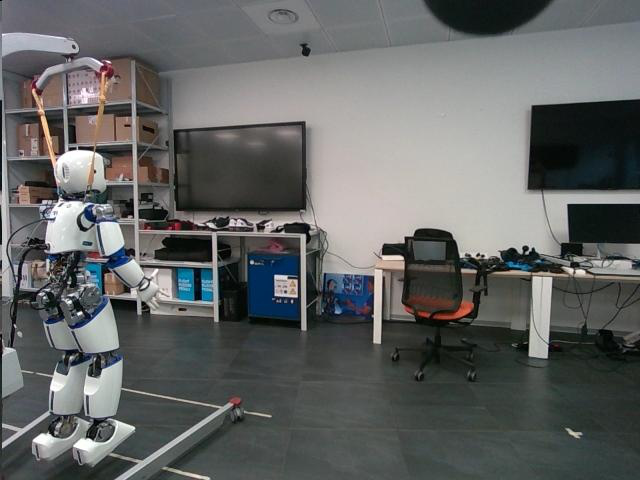

In [4]:
# input_image = Image.open(requests.get("http://images.cocodataset.org/val2017/000000467848.jpg", stream=True).raw)
input_image = Image.open("25.jpg")
input_image

In [5]:
input_image.size

# new_width = int(input_image.width * 0.2)
# new_height = int(input_image.height * 0.2)
# new_size = (new_width, new_height)

# # Resize the image
# shrunk_image = input_image.resize(new_size, Image.Resampling.LANCZOS)

# # Save the resized image
# shrunk_image.save("screwdrivers-mini.jpg")
# shrunk_image.size

(640, 480)

In [6]:
import importlib
from mask2former import maskformer_model
importlib.reload(maskformer_model)

<module 'mask2former.maskformer_model' from '/home/r1-user/miniconda3/envs/odise/lib/python3.9/site-packages/mask2former/maskformer_model.py'>

In [7]:
# vocab = "black pickup truck, pickup truck; blue sky, sky; road; tree"
# vocab = "chair; floor; ceiling; wall; table; tv; light; display; person; robot; other"

# vocab = "cat; dog; person, human, man, woman, boy, child; floor, ground; wall; tv, monitor; book; cup; light; curtains"
# vocab = "chair; picture; floor; ceiling; robot; table; monitor; wall; laptop; screen; computer; tv; shelf; desk; window; person; other"

# vocab = "person; man; woman; child; cross; candles; ground; sky; cloud; wall; fire"

vocab = "floor; ceiling; wall; table; laptop; lamp; plant; vase; jar; panel; couch; sofa; carpet; door"


In [8]:

# vocab = "cat; dog; person; floor; wall; tv; book; cup; light; curtains"
# vocab = "two cats are watching dog and person in the tv…"
# label_list = ["COCO; ADE", "LVIS"]
label_list = []
import time
start = time.time()
preds, vis_output, metadata = inference(input_image, vocab, label_list)
print(time.time() - start)

Image shape: torch.Size([3, 1024, 1365])
[10/28 14:39:58 odise.modeling.meta_arch.clip]: Using provided CLIP model
[10/28 14:39:58 odise.modeling.meta_arch.clip]: Built text_embed of shape torch.Size([14, 768]) for 14 labels: (('a photo of a floor.',), ('a photo of a ceiling.',), ('a photo of a wall.',), ('a photo of a table.',), ('a photo of a laptop.',), ('a photo of a lamp.',), ('a photo of a plant.',), ('a photo of a vase.',), ('a photo of a jar.',), ('a photo of a panel.',), ('a photo of a couch.',), ('a photo of a sofa.',), ('a photo of a carpet.',), ('a photo of a door.',))
test labels: [['floor'], ['ceiling'], ['wall'], ['table'], ['laptop'], ['lamp'], ['plant'], ['vase'], ['jar'], ['panel'], ['couch'], ['sofa'], ['carpet'], ['door']]
[10/28 14:39:58 odise.modeling.meta_arch.clip]: Using provided CLIP model
[10/28 14:39:58 odise.modeling.meta_arch.clip]: Built text_embed of shape torch.Size([14, 768]) for 14 labels: (('a photo of a floor.',), ('a photo of a ceiling.',), ('a pho

/home/r1-user/miniconda3/envs/odise/lib/python3.9/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1670525551200/work/aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


480 640 (1024, 1365)
4.5703206062316895


In [15]:
print(metadata)

Metadata(name='odise_demo_metadata', thing_classes=['floor', 'ceiling', 'wall', 'table', 'laptop', 'lamp', 'plant', 'vase', 'jar', 'panel', 'couch', 'sofa', 'carpet', 'door'], stuff_classes=['floor', 'ceiling', 'wall', 'table', 'laptop', 'lamp', 'plant', 'vase', 'jar', 'panel', 'couch', 'sofa', 'carpet', 'door'], thing_colors=[array([0., 0., 1.], dtype=float32), array([0.667, 0.333, 1.   ], dtype=float32), array([0.667, 0.   , 1.   ], dtype=float32), array([0.143, 0.143, 0.143], dtype=float32), array([0.   , 0.667, 0.   ], dtype=float32), array([0.   , 0.333, 1.   ], dtype=float32), array([1.   , 0.667, 1.   ], dtype=float32), array([1., 1., 0.], dtype=float32), array([0.   , 0.667, 0.5  ], dtype=float32), array([0.   , 0.333, 0.   ], dtype=float32), array([0.   , 0.667, 1.   ], dtype=float32), array([0.333, 0.333, 0.5  ], dtype=float32), array([0.667, 0.   , 1.   ], dtype=float32), array([0.333, 0.667, 1.   ], dtype=float32)], stuff_colors=[array([0., 0., 1.], dtype=float32), array([0

In [16]:
preds['mask_pred'].shape

torch.Size([100, 480, 640])

In [17]:
from torch.nn import functional as F
import matplotlib.pyplot as plt

masked_out_percentages = []

for i in range(0, 100):

   # masked_image = preds["clip_results"]["patch_mask"][:, i, :, :].unsqueeze(0)

   new_width, new_height = input_image.size

   # masked_image = F.interpolate(masked_image, size=(new_height, new_width), mode='bilinear'
   #                                        , align_corners=False
   #                                     )

   # masked_image = masked_image < 0.5

   # masked_image = masked_image.squeeze().squeeze().cpu().numpy()

   # masked_image.shape

   masked_image = preds['mask_pred'][i]

   masked_image = masked_image.sigmoid()

   masked_image = masked_image < 0.5

   masked_image = masked_image.squeeze().squeeze()

   # pixels containing ones are masked out
   mskd_out_prcntg = torch.count_nonzero(masked_image) / masked_image.shape[0] * masked_image.shape[1]

   masked_out_percentages.append(mskd_out_prcntg)

sort_index = torch.argsort(torch.tensor(masked_out_percentages))

sort_index = list(sort_index)

sort_index.reverse()

# word_list = vocab.split("; ") + ["other"]
word_list = vocab.split("; ")

# from odise.modeling.meta_arch.odise import WordEmbed
# word_embedder = WordEmbed(256)
# word_embedder.eval()
from odise.data.build import prompt_labels

category_list = [[w] for w in word_list]
# word_embedder = preds["word_embedder"].cpu()
word_embedder = preds["word_embedder"]
word_list = prompt_labels(labels=category_list, prompt="photo")

# embeddings = word_embedder.get_and_cache_test_text_embed(labels=word_list).cpu()
embeddings = word_embedder.get_and_cache_test_text_embed(labels=word_list)

word_embedder.text_proj.eval()
# projected_embeddings = word_embedder.text_proj(embeddings).cpu().detach()
projected_embeddings = word_embedder.text_proj(embeddings).detach()

# print(embeddings.requires_grad)
# print(projected_embeddings.requires_grad)

In [18]:
masks_foreground_logits = preds["mask_foreground_logits"].squeeze()

masks_foreground_logits.shape

torch.Size([100, 2])

In [19]:

def get_max_similarity_list_index(target_emb, emb_list, logit_scale=None):
   from torch import nn
   similarities = []
   if not logit_scale:
      logit_scale = nn.Parameter(torch.ones([]) * np.log(1 / 0.07))
      logit_scale = torch.clamp(logit_scale.exp(), max=100)

   target_emb = F.normalize(target_emb, dim=-1)

   emb_list = F.normalize(emb_list, dim=-1)
   similarities = logit_scale.detach() * (target_emb @ emb_list.t())

   max_index = similarities.argmax()
   return max_index

# mask_embeds = preds["clip_results"]["mask_embed"].squeeze().cpu()

# projected_clip_embeds = word_embedder.text_proj(mask_embeds).cpu().detach()

# projected_mask_embeds = preds["projected_mask_embed"].squeeze().cpu()

mask_embeds = preds["clip_results"]["mask_embed"].squeeze()

assert next(word_embedder.text_proj.parameters()).is_cuda

projected_clip_embeds = word_embedder.text_proj(mask_embeds).detach()

projected_mask_embeds = preds["projected_mask_embed"].squeeze()

# approach with averaged embedding is not effective

# projected_clip_mask_embeds = word_embedder.text_proj(mask_embeds).detach()

# averaged_embs = []

# for proj_clip_emb, proj_mask_emb in zip(projected_clip_mask_embeds, projected_mask_embeds):
#    proj_clip_emb = proj_clip_emb.unsqueeze(0)
#    proj_mask_emb = proj_mask_emb.unsqueeze(0)
#    print(torch.cat((proj_clip_emb, proj_mask_emb)).shape)

#    print(torch.mean(torch.cat((proj_clip_emb, proj_mask_emb)), 0).shape)

#    averaged_embs.append(torch.mean(torch.cat((proj_clip_emb, proj_mask_emb)), 0))

# averaged_clip_maskformer_embeddings = torch.from_numpy(np.array(averaged_embs))

# print(averaged_clip_maskformer_embeddings.shape)


In [23]:
# import copy
# # ls = copy.deepcopy(preds["logit_scale"]).cpu()
# ls = copy.deepcopy(preds["logit_scale"])

# valid_mask_counter = 0

# counter = 0

# pred_open_logits_bases = []

# import torch.nn.functional as F

# for i in sort_index:

#    masked_image = preds['mask_pred'][i]

#    masked_image = masked_image.sigmoid()

#    masked_image = masked_image < 0.5

#    # masked_image = masked_image.squeeze().squeeze().cpu().numpy()

#    masked_image = masked_image.squeeze().squeeze()

#    # one_percentage = np.sum(masked_image) / (masked_image.shape[0] * masked_image.shape[1])
#    one_percentage = torch.sum(masked_image) / (masked_image.shape[0] * masked_image.shape[1])
#    zeros_percentage = 1 - one_percentage

#    if zeros_percentage >= 0:

#       print(counter, i, zeros_percentage)

#       print(f"CLIP classification: {word_list[get_max_similarity_list_index(mask_embeds[i], embeddings)]}")

#       print(f"Projected CLIP classification: {word_list[get_max_similarity_list_index(projected_clip_embeds[i], projected_embeddings)]}")

#       # print(projected_mask_embeds.is_cuda)
#       # print(projected_embeddings.is_cuda)
#       # print(ls.is_cuda)

#       print(f"Mask2Former classification: {word_list[get_max_similarity_list_index(projected_mask_embeds[i], projected_embeddings, ls)]}")

#       mask2former_logits = model.cal_pred_open_logits2(projected_mask_embeds[i], projected_embeddings, ls, word_list)

#       clip_logits = model.clip_head.clip.pred_logits2(mask_embeds[i].unsqueeze(0).unsqueeze(0).cuda(), embeddings.cuda(), word_list).squeeze().squeeze()

#       # mask2former_null_score = model.cal_pred_open_logits2(projected_mask_embeds[i], projected_embeddings[-1].unsqueeze(0), ls, [word_list[-1]])

#       # clip_null_score = model.clip_head.clip.pred_logits2(mask_embeds[i].unsqueeze(0).unsqueeze(0).cuda(), embeddings[-1].unsqueeze(0).cuda(), [word_list[-1]]).squeeze().squeeze()

#       # projected_clip_null_score = model.clip_head.clip.pred_logits2(projected_clip_embeds[i].unsqueeze(0).unsqueeze(0).cuda(), projected_embeddings[-1].unsqueeze(0).cuda(), [word_list[-1]]).squeeze().squeeze()
#       # # print(projected_mask_embeds[i].unsqueeze(0).shape, projected_embeddings[-1].unsqueeze(0).shape)

#       # mask2former_null_similarity = F.cosine_similarity(projected_mask_embeds[i].unsqueeze(0), projected_embeddings[-1].unsqueeze(0))

#       # # mask2former_null_distance = torch.cdist(projected_mask_embeds[i].unsqueeze(0), projected_embeddings[-1].unsqueeze(0))

#       # # print(embeddings[-1].unsqueeze(0).shape, mask_embeds[i].unsqueeze(0).shape)

#       # clip_null_similarity = F.cosine_similarity(mask_embeds[i].unsqueeze(0), embeddings[-1].unsqueeze(0))

#       # # clip_null_distance = torch.cdist(mask_embeds[i].unsqueeze(0), embeddings[-1].unsqueeze(0))

#       # projected_clip_null_similarity = F.cosine_similarity(projected_clip_embeds[i].unsqueeze(0), projected_embeddings[-1].unsqueeze(0))

#       # projected_clip_null_distance = torch.cdist(projected_clip_embeds[i].unsqueeze(0), projected_embeddings[-1].unsqueeze(0))

#       pred_open_prob = mask2former_logits.softmax(dim=-1)

#       mask_pred_open_prob = clip_logits.softmax(dim=-1)

#       # NOTE: logits are multiplied with logit_scale,
#       # avoid double scale, which cause overflow in softmax
#       pred_open_logits_base = (
#          (pred_open_prob ** (1 - .35) * mask_pred_open_prob** .35).log()
#          # * outputs["logit_scale"]
#       )
#       pred_open_logits_bases.append(pred_open_logits_base.unsqueeze(0))

#       # max_index = np.array(pred_open_logits_base.detach()).argmax()

#       max_index = pred_open_logits_base.argmax()

#       # scores, labels = F.softmax(pred_open_logits_base, dim=-1).max(-1)

#       # assert labels == torch.tensor(max_index)

#       # keep = labels.ne(len(embeddings) - 1) & (scores > 0)

#       # print(masks_foreground_logits[i])

#       scores, labels = F.softmax(masks_foreground_logits[i], dim=-1).max(-1)

#       # print(scores, labels)

#       keep = labels.ne(1)

#       print(f"keep: {keep}")

#       # print(pred_open_logits_base.shape)

#       print(f"geometric mean classification: {word_list[max_index]}")

#       # print(f"clip_null_score: {clip_null_score}")

#       # # print(f"clip_null_dist: {clip_null_distance}")

#       # print(f"projected_clip_null_score: {projected_clip_null_score}")

#       # # print(f"projected_clip_null_dist: {projected_clip_null_distance}")

#       # print(f"mask2former_null_score: {mask2former_null_score}")

#       # print(f"clip_null_similarity: {clip_null_similarity}")

#       # print(f"projected_clip_null_similarity: {projected_clip_null_similarity}")

#       # print(f"mask2former_null_similarity: {mask2former_null_similarity}")

#       # print(f"mask2former_null_dist: {mask2former_null_distance}")

#       if keep or True:
#          valid_mask_counter += 1

#          # print(word_list[get_max_similarity_list_index(averaged_clip_maskformer_embeddings[i], projected_embeddings)])

#          label_index_to_color_dict = {i : plt.cm.get_cmap('tab20')(i) for i in range(2)}

#          mask_color = np.zeros((masked_image.shape[0], masked_image.shape[1], 4), dtype=np.float64)
#          for i in range(masked_image.shape[0]):
#             for j in range(masked_image.shape[1]):
#                mask_color[i, j] = label_index_to_color_dict[masked_image[i, j].item()]

#          labels = ["False", "True"]

#          plt.imshow(input_image)
#          plt.imshow(mask_color, alpha=.8)

#          plt.legend(handles=[plt.Rectangle((0,0),1,1, color=label_index_to_color_dict[i], label=labels[i]) for i in np.unique(masked_image.cpu())], loc='upper left', bbox_to_anchor=(1, 1))

#          plt.show()

#          # print(masked_image)

#    counter += 1

In [24]:
import torch.nn.functional as F

ls = preds["logit_scale"].clone()  # Shallow copy or clone if needed
valid_mask_counter = 0
counter = 0
pred_open_logits_bases = []

# Precompute color mapping outside the loop
label_index_to_color_dict = {i: plt.cm.get_cmap('tab20')(i) for i in range(2)}

category_overlapping_list = []

train_labels = {l for label in model.clip_head.train_labels for l in label}

labels = prompt_labels(word_list, model.clip_head.prompt)

for test_label in category_list:
    category_overlapping_list.append(not set(train_labels).isdisjoint(set(test_label)))

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

category_overlapping_mask = torch.tensor(
    category_overlapping_list, device=device, dtype=torch.long
)


/tmp/ipykernel_32590/3966058344.py:9: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  label_index_to_color_dict = {i: plt.cm.get_cmap('tab20')(i) for i in range(2)}


In [25]:
category_overlapping_list

[True,
 True,
 True,
 True,
 True,
 True,
 False,
 True,
 False,
 False,
 True,
 True,
 False,
 True]

0 tensor(66) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0699], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 2.960141897201538
geometric mean classification: ['a photo of a jar.']


/tmp/ipykernel_32590/1696458811.py:84: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  handles=[plt.Rectangle((0, 0), 1, 1, color=label_index_to_color_dict[i], label=labels[i]) for i in np.unique(masked_image.cpu())],


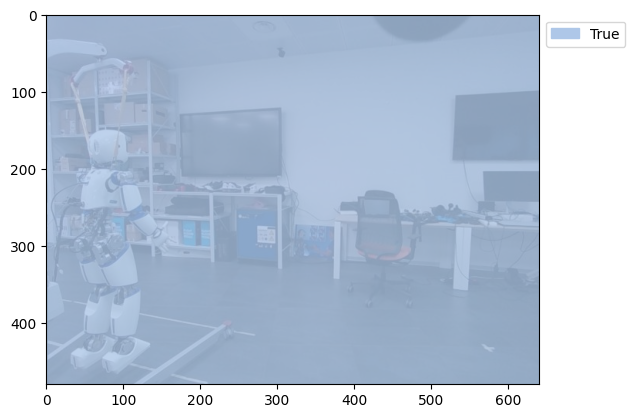

1 tensor(64) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0523], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 2.217500925064087
geometric mean classification: ['a photo of a jar.']


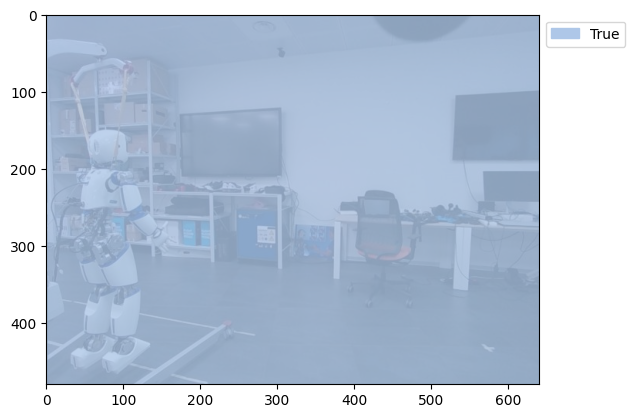

2 tensor(63) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a floor.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.2647], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -11.2156982421875
geometric mean classification: ['a photo of a jar.']


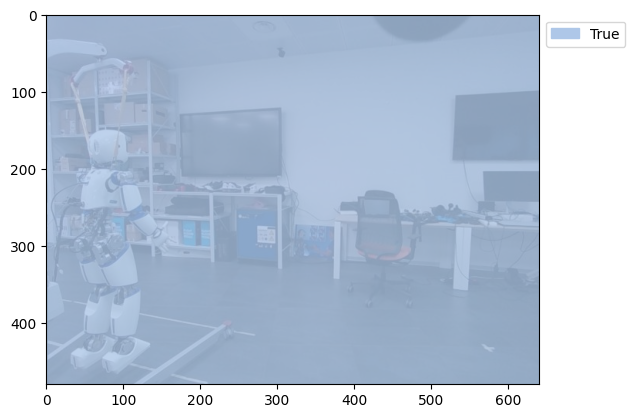

3 tensor(56) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1119], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 4.742002487182617
geometric mean classification: ['a photo of a jar.']


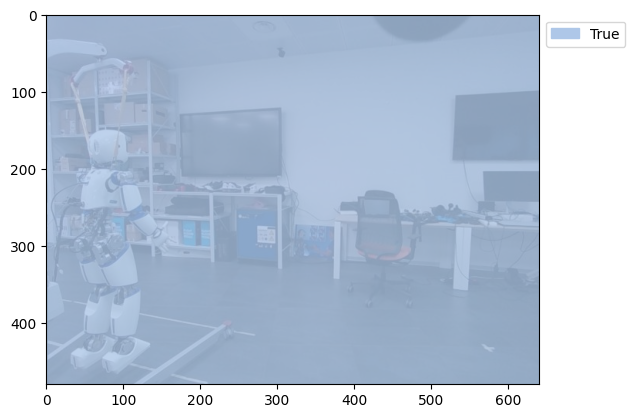

4 tensor(10) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0108], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -0.45794999599456787
geometric mean classification: ['a photo of a jar.']


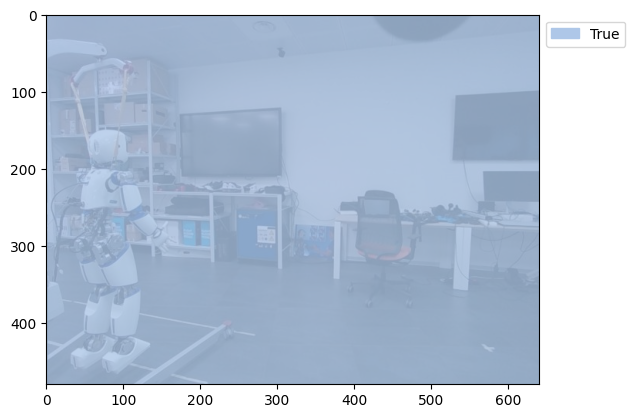

5 tensor(86) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.2244], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -9.51004695892334
geometric mean classification: ['a photo of a jar.']


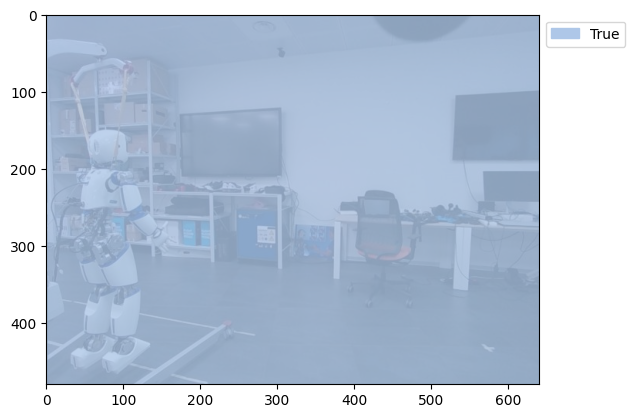

6 tensor(54) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0015], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -0.06421466171741486
geometric mean classification: ['a photo of a jar.']


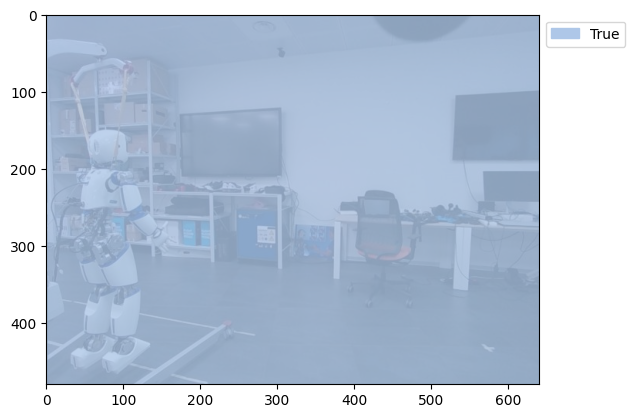

7 tensor(52) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0754], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 3.1961326599121094
geometric mean classification: ['a photo of a jar.']


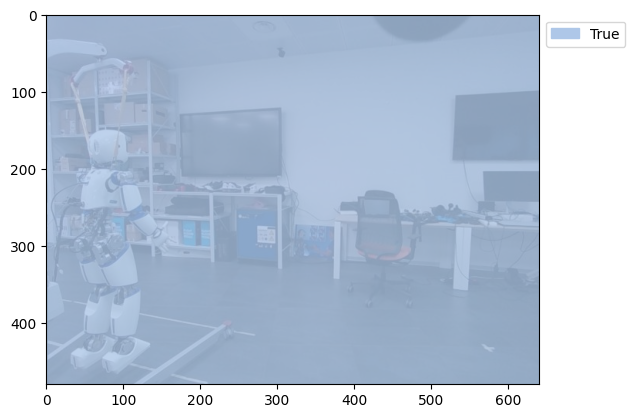

8 tensor(91) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a floor.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.3993], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -16.920427322387695
geometric mean classification: ['a photo of a floor.']


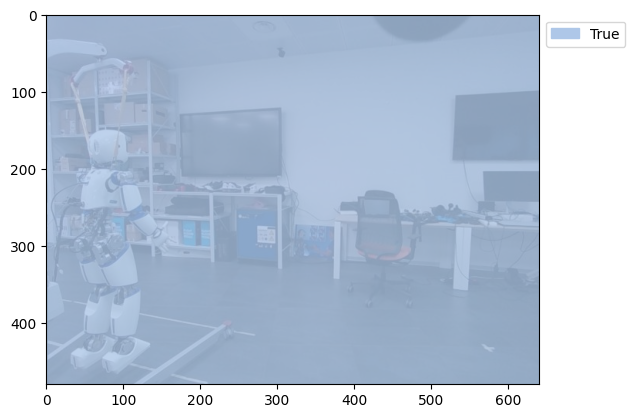

9 tensor(43) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0200], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 0.8491453528404236
geometric mean classification: ['a photo of a jar.']


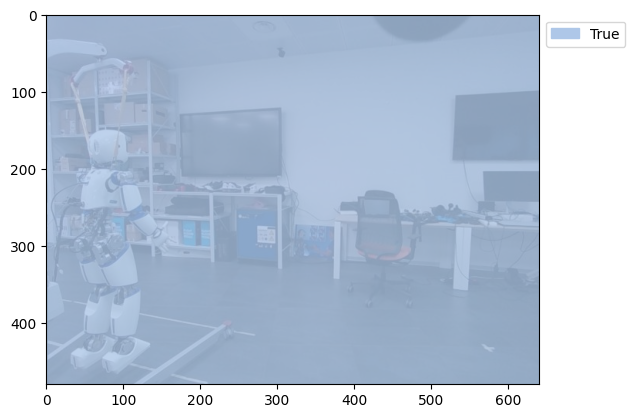

10 tensor(16) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0147], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -0.624544084072113
geometric mean classification: ['a photo of a jar.']


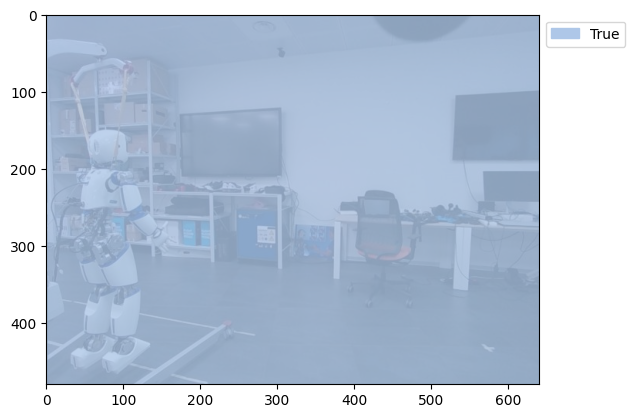

11 tensor(39) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0430], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -1.8211760520935059
geometric mean classification: ['a photo of a jar.']


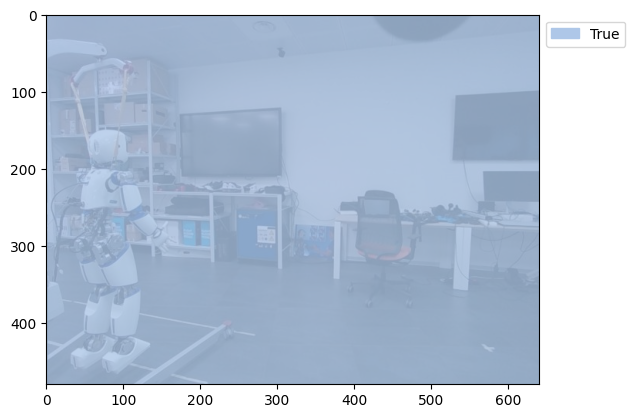

12 tensor(96) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.1968], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -8.34058952331543
geometric mean classification: ['a photo of a floor.']


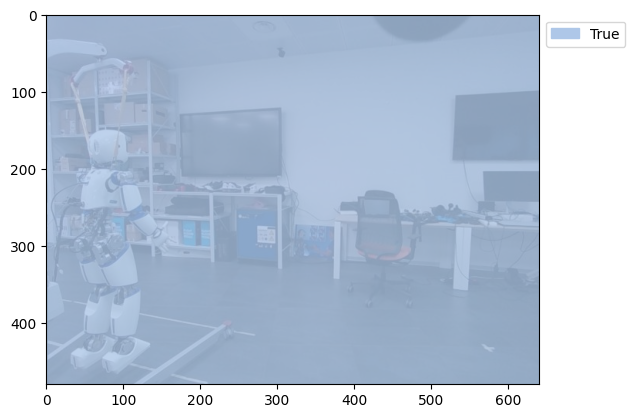

13 tensor(31) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0013], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 0.05679725110530853
geometric mean classification: ['a photo of a jar.']


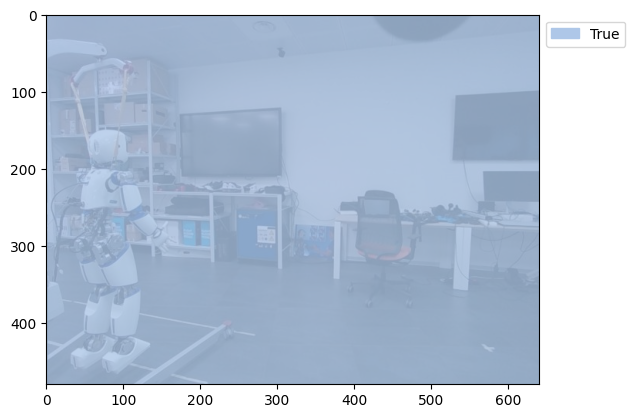

14 tensor(4) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0336], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 1.4227299690246582
geometric mean classification: ['a photo of a jar.']


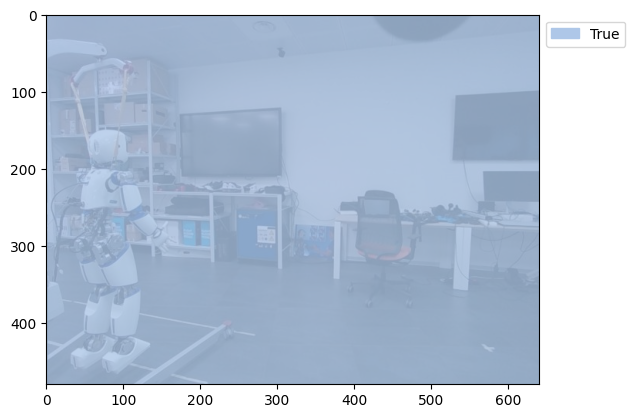

15 tensor(0) tensor(0., device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0569], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 2.409414291381836
geometric mean classification: ['a photo of a jar.']


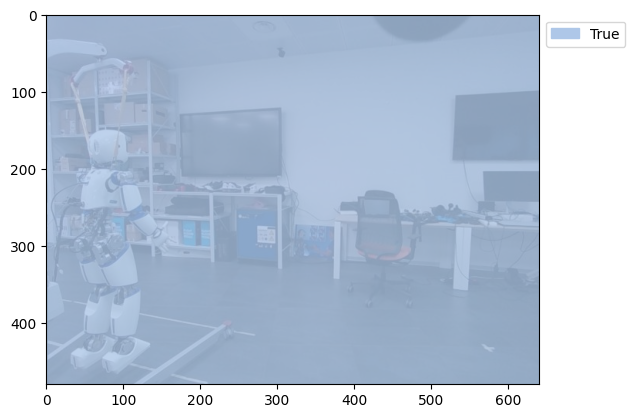

16 tensor(27) tensor(0.0002, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a wall.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2654], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 11.246405601501465
geometric mean classification: ['a photo of a wall.']


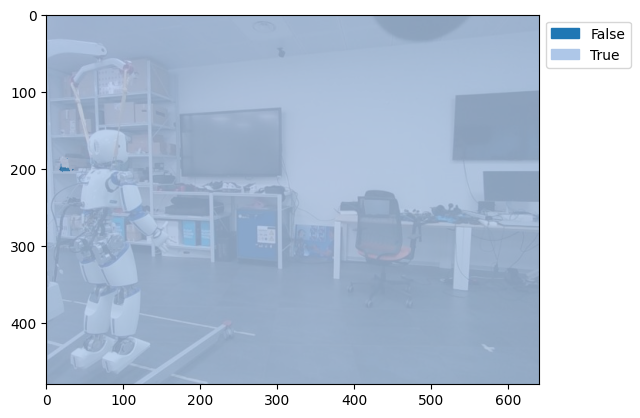

17 tensor(51) tensor(0.0003, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0106], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -0.4483732283115387
geometric mean classification: ['a photo of a panel.']


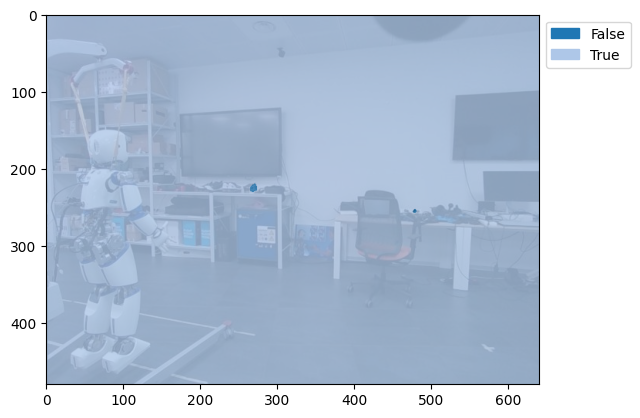

18 tensor(89) tensor(0.0004, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0399], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -1.6893870830535889
geometric mean classification: ['a photo of a panel.']


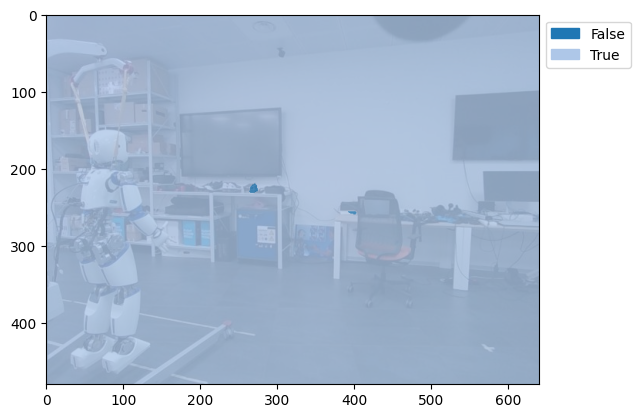

19 tensor(81) tensor(0.0004, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0254], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -1.0746766328811646
geometric mean classification: ['a photo of a panel.']


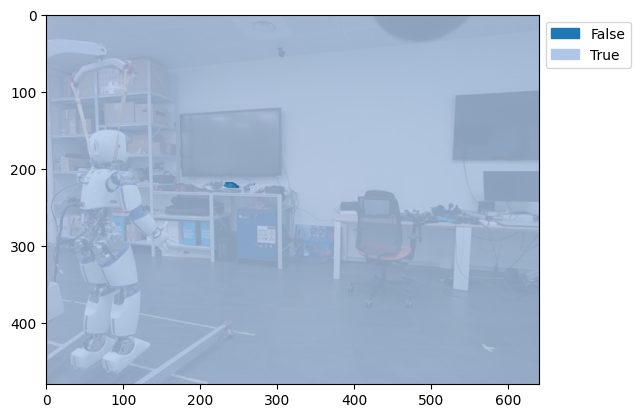

20 tensor(36) tensor(0.0005, device='cuda:0')
keep: True
CLIP classification: ['a photo of a plant.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0265], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -1.1234164237976074
geometric mean classification: ['a photo of a panel.']


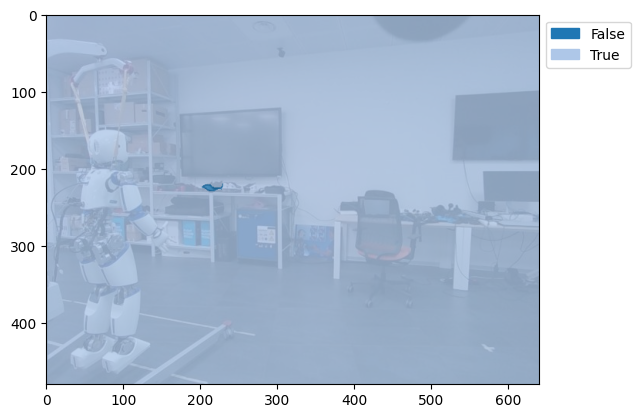

21 tensor(82) tensor(0.0005, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0849], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -3.5963261127471924
geometric mean classification: ['a photo of a panel.']


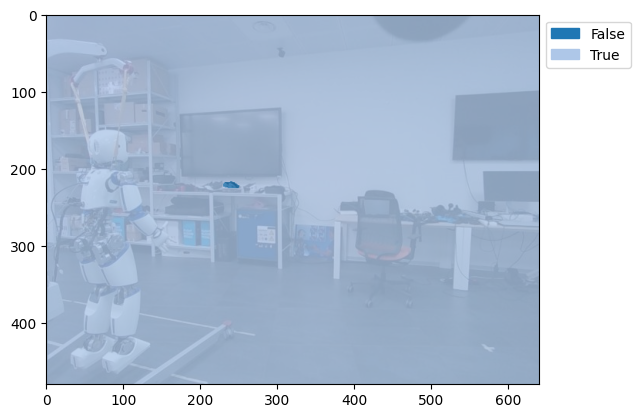

22 tensor(61) tensor(0.0005, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a wall.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2402], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 10.17811107635498
geometric mean classification: ['a photo of a wall.']


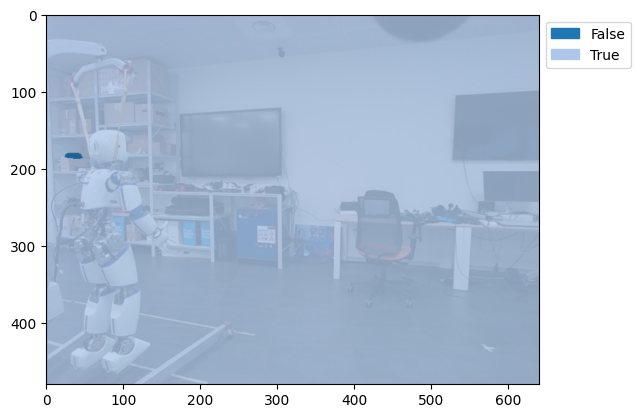

23 tensor(26) tensor(0.0005, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a laptop.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0903], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -3.8254120349884033
geometric mean classification: ['a photo of a panel.']


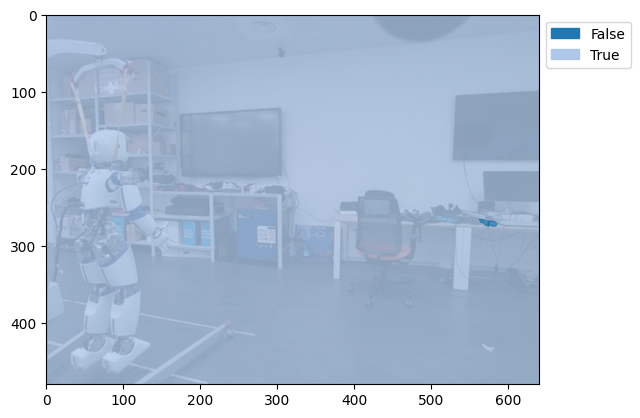

24 tensor(97) tensor(0.0005, device='cuda:0')
keep: True
CLIP classification: ['a photo of a plant.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0954], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 4.0402398109436035
geometric mean classification: ['a photo of a panel.']


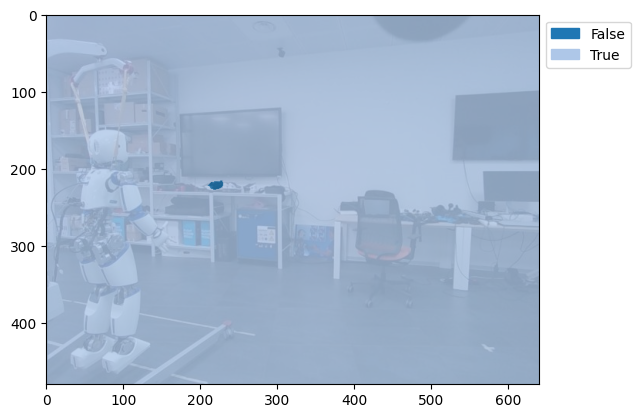

25 tensor(88) tensor(0.0008, device='cuda:0')
keep: True
CLIP classification: ['a photo of a carpet.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0074], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 0.31241294741630554
geometric mean classification: ['a photo of a panel.']


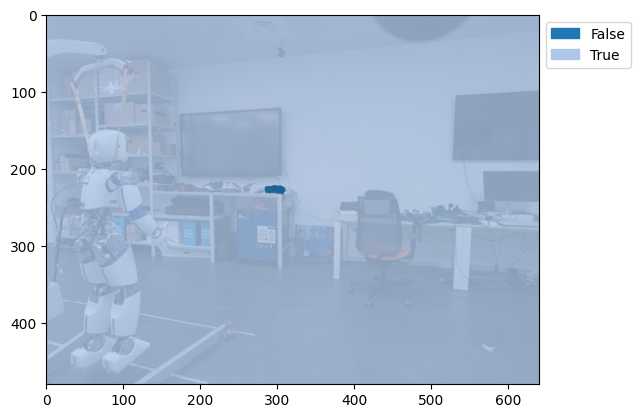

26 tensor(13) tensor(0.0008, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0290], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -1.228469729423523
geometric mean classification: ['a photo of a panel.']


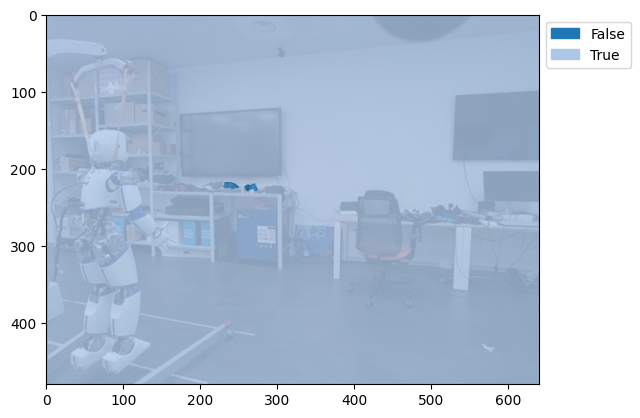

27 tensor(25) tensor(0.0008, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a table.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2518], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 10.66939926147461
geometric mean classification: ['a photo of a table.']


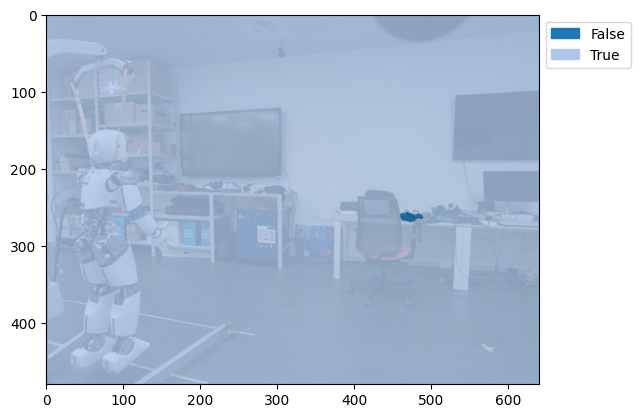

28 tensor(85) tensor(0.0009, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a sofa.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1136], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 4.813570976257324
geometric mean classification: ['a photo of a floor.']


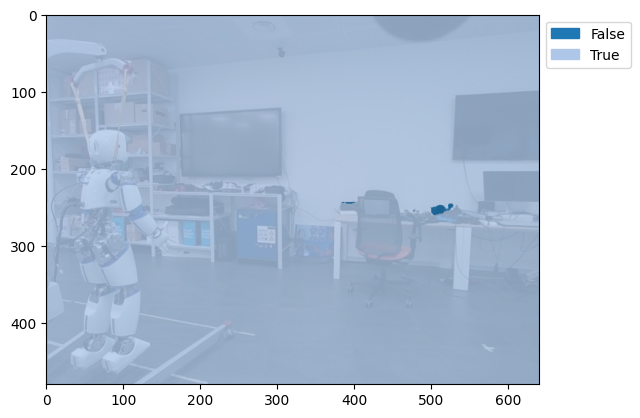

29 tensor(92) tensor(0.0009, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a sofa.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1287], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 5.454610824584961
geometric mean classification: ['a photo of a floor.']


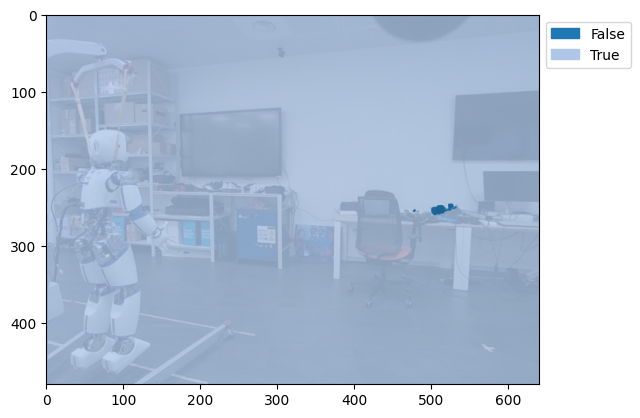

30 tensor(62) tensor(0.0009, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1089], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 4.613167762756348
geometric mean classification: ['a photo of a panel.']


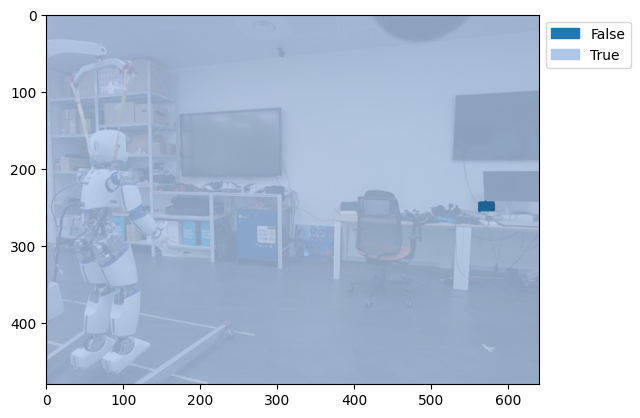

31 tensor(34) tensor(0.0010, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2440], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 10.337178230285645
geometric mean classification: ['a photo of a table.']


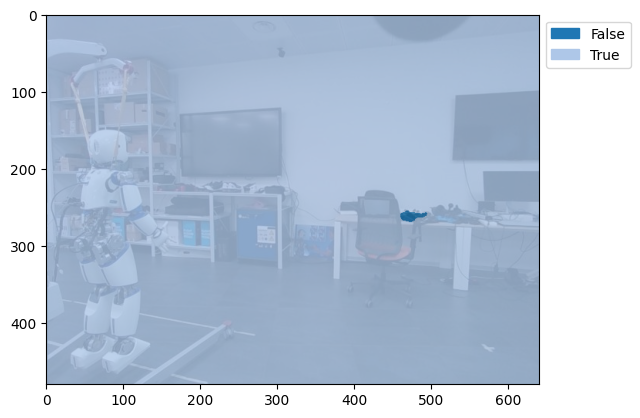

32 tensor(14) tensor(0.0011, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.4205], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 17.815576553344727
geometric mean classification: ['a photo of a panel.']


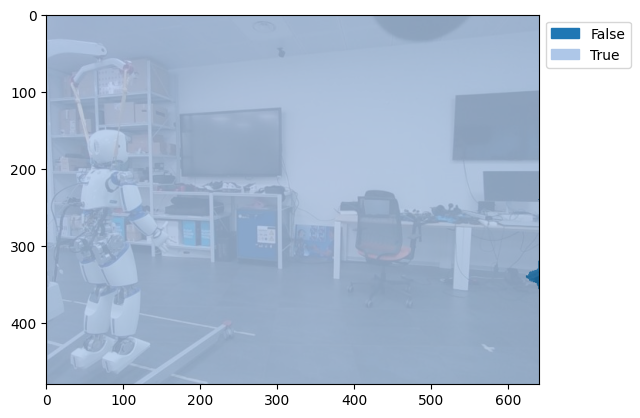

33 tensor(48) tensor(0.0011, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a laptop.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1134], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 4.805720329284668
geometric mean classification: ['a photo of a panel.']


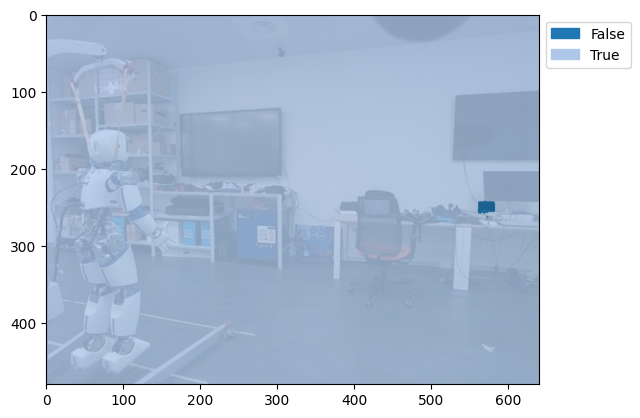

34 tensor(24) tensor(0.0011, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a wall.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1344], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 5.6950507164001465
geometric mean classification: ['a photo of a wall.']


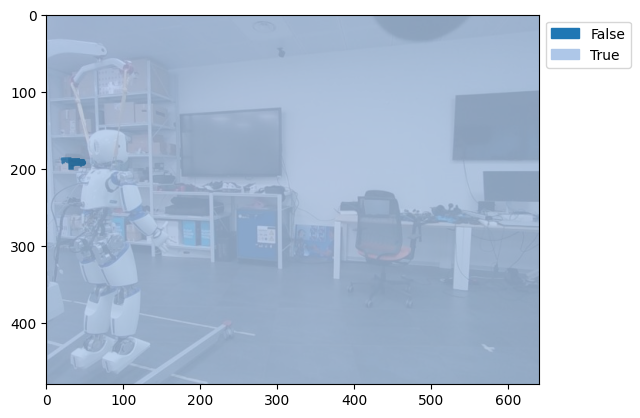

35 tensor(28) tensor(0.0011, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.3079], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 13.048083305358887
geometric mean classification: ['a photo of a table.']


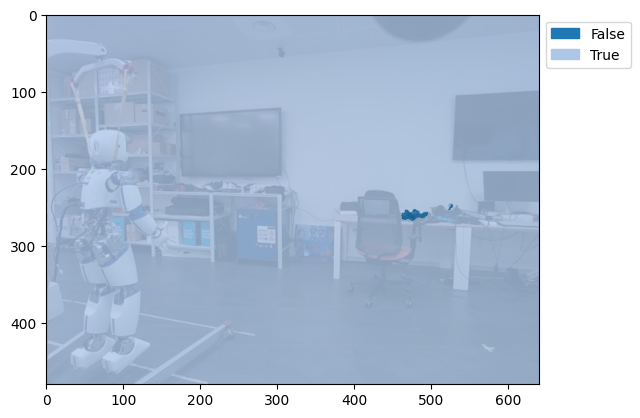

36 tensor(73) tensor(0.0012, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a sofa.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0720], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -3.0517804622650146
geometric mean classification: ['a photo of a panel.']


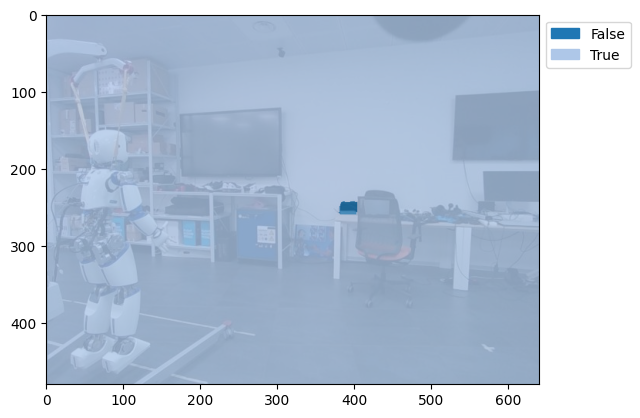

37 tensor(17) tensor(0.0017, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a carpet.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2323], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 9.84450912475586
geometric mean classification: ['a photo of a panel.']


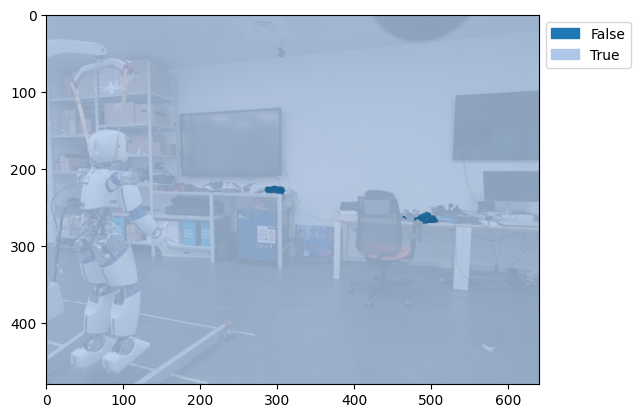

38 tensor(77) tensor(0.0017, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a jar.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0940], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 3.9840261936187744
geometric mean classification: ['a photo of a jar.']


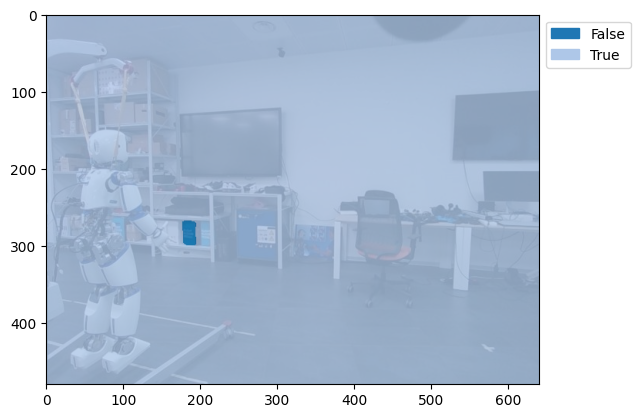

39 tensor(1) tensor(0.0018, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a wall.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1628], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 6.896261692047119
geometric mean classification: ['a photo of a wall.']


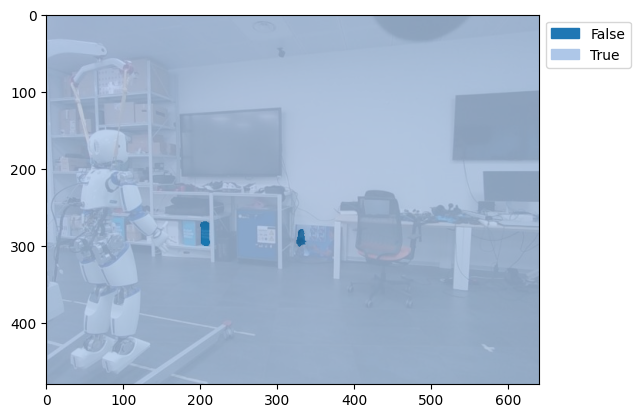

40 tensor(47) tensor(0.0018, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a table.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2776], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 11.763544082641602
geometric mean classification: ['a photo of a table.']


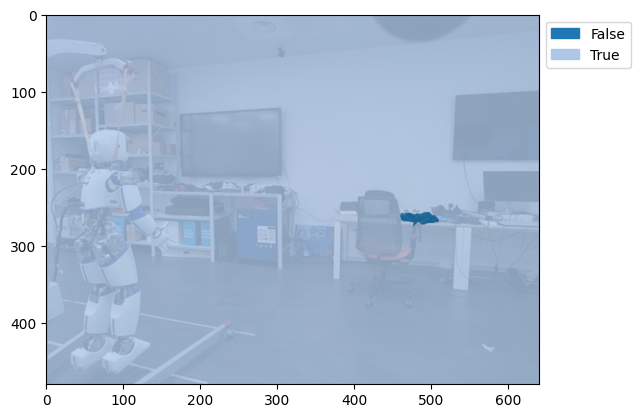

41 tensor(70) tensor(0.0019, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a laptop.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2300], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 9.744636535644531
geometric mean classification: ['a photo of a panel.']


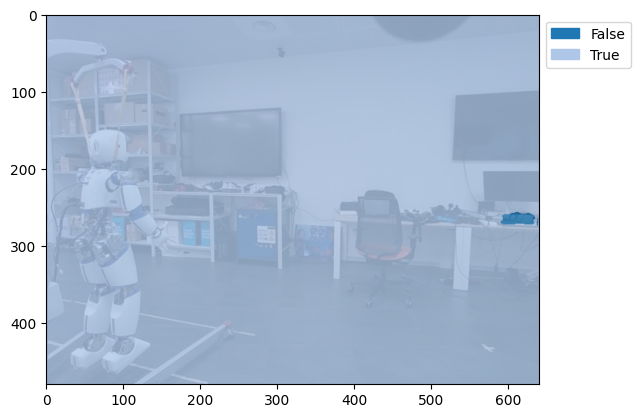

42 tensor(46) tensor(0.0019, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a carpet.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2354], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 9.973226547241211
geometric mean classification: ['a photo of a panel.']


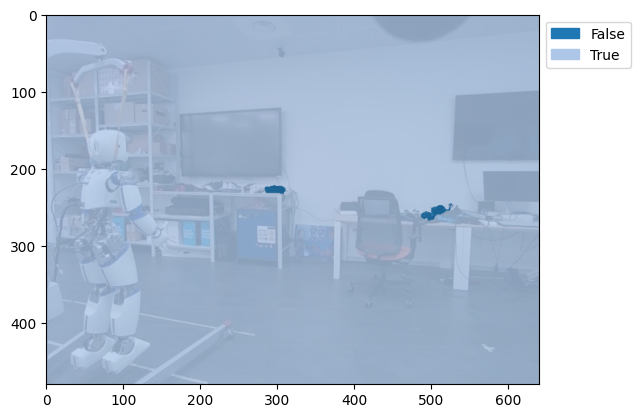

43 tensor(95) tensor(0.0019, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a wall.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2881], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 12.209280967712402
geometric mean classification: ['a photo of a wall.']


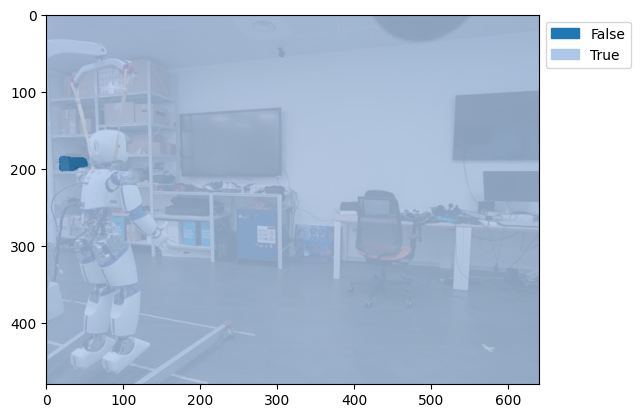

44 tensor(80) tensor(0.0020, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a laptop.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2334], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 9.887886047363281
geometric mean classification: ['a photo of a panel.']


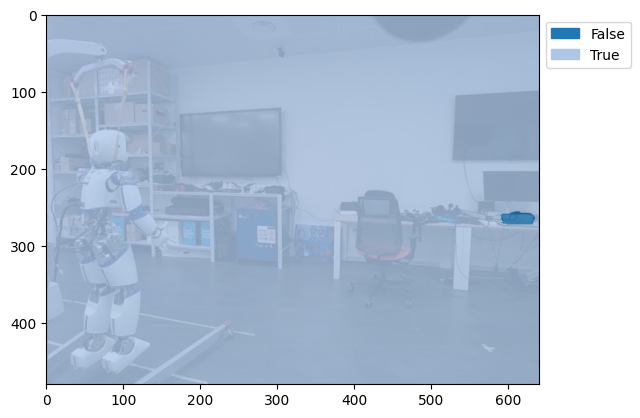

45 tensor(49) tensor(0.0022, device='cuda:0')
keep: True
CLIP classification: ['a photo of a door.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0140], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 0.5940688252449036
geometric mean classification: ['a photo of a jar.']


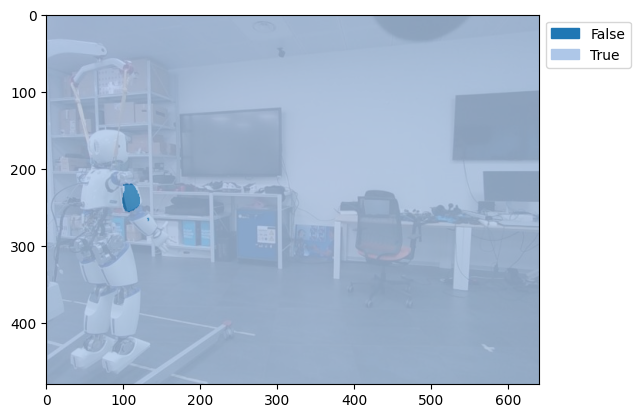

46 tensor(44) tensor(0.0022, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a table.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2439], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 10.333720207214355
geometric mean classification: ['a photo of a table.']


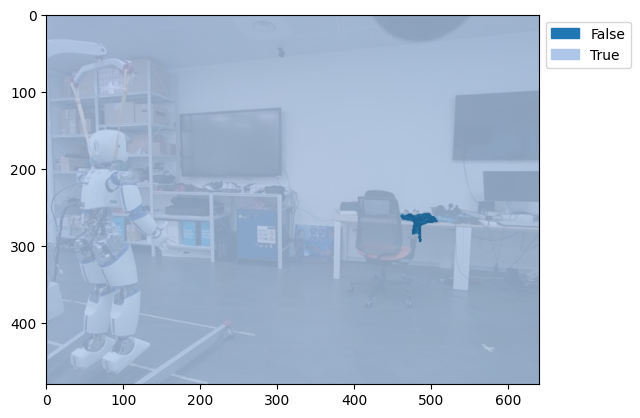

47 tensor(40) tensor(0.0024, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a table.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.3044], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 12.898758888244629
geometric mean classification: ['a photo of a table.']


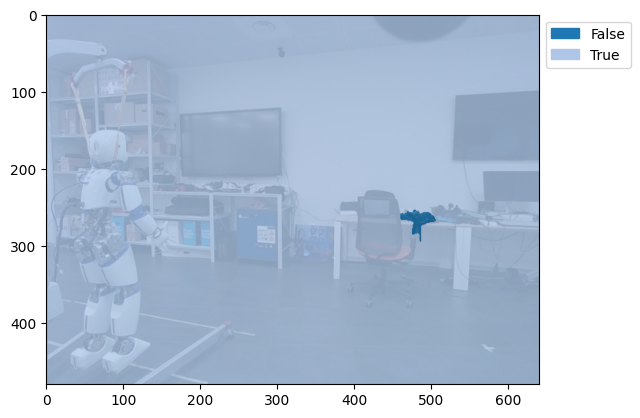

48 tensor(38) tensor(0.0025, device='cuda:0')
keep: True
CLIP classification: ['a photo of a ceiling.']
Projected CLIP classification: ['a photo of a wall.']
Mask2Former classification: ['a photo of a ceiling.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0645], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 2.7319791316986084
geometric mean classification: ['a photo of a ceiling.']


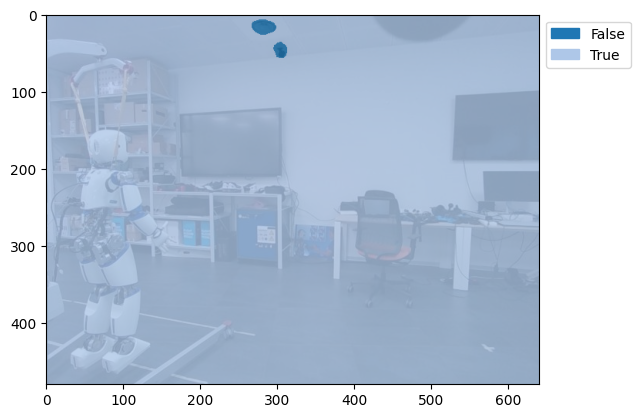

49 tensor(93) tensor(0.0026, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0863], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 3.6584246158599854
geometric mean classification: ['a photo of a panel.']


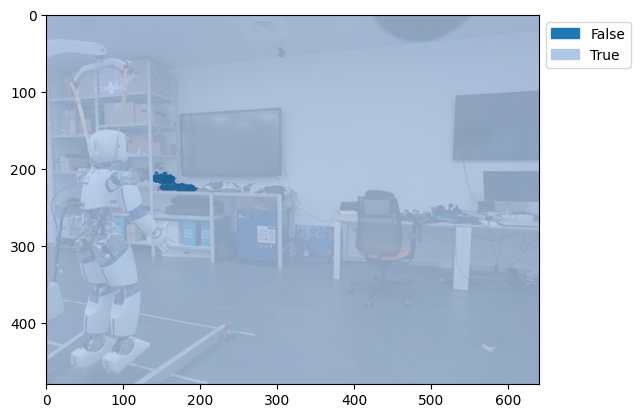

50 tensor(68) tensor(0.0030, device='cuda:0')
keep: True
CLIP classification: ['a photo of a plant.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2224], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 9.422293663024902
geometric mean classification: ['a photo of a wall.']


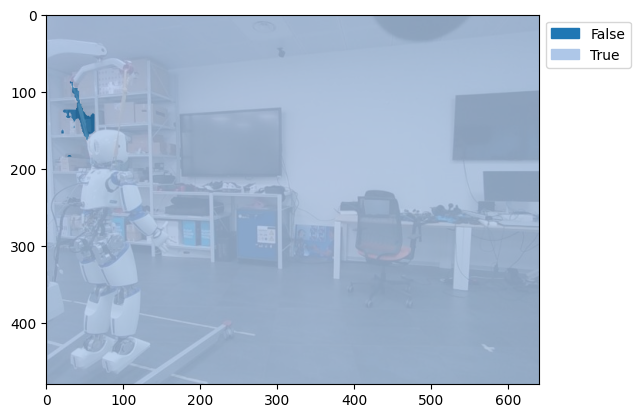

51 tensor(94) tensor(0.0030, device='cuda:0')
keep: True
CLIP classification: ['a photo of a floor.']
Projected CLIP classification: ['a photo of a floor.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.4158], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 17.619834899902344
geometric mean classification: ['a photo of a panel.']


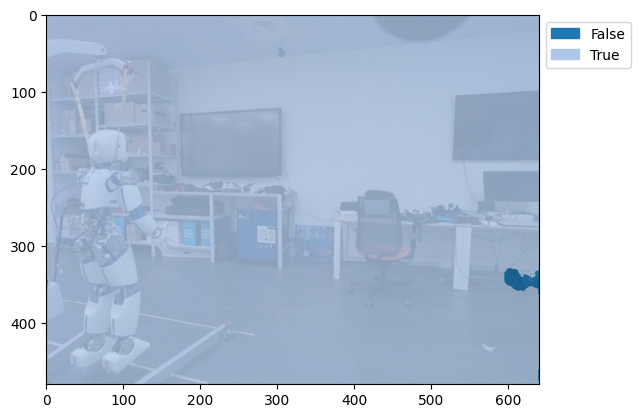

52 tensor(76) tensor(0.0032, device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a wall.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0022], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -0.09533685445785522
geometric mean classification: ['a photo of a wall.']


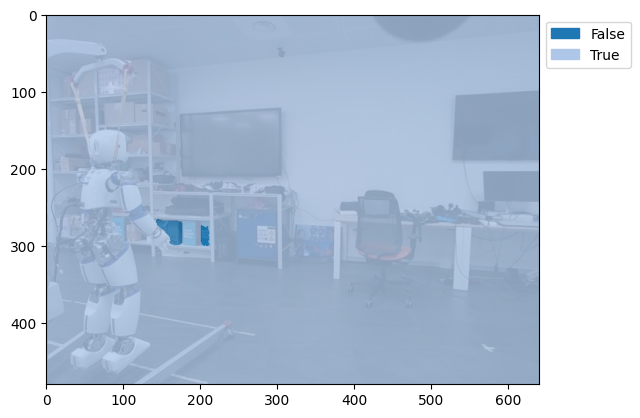

53 tensor(9) tensor(0.0034, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a wall.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.3736], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 15.830751419067383
geometric mean classification: ['a photo of a wall.']


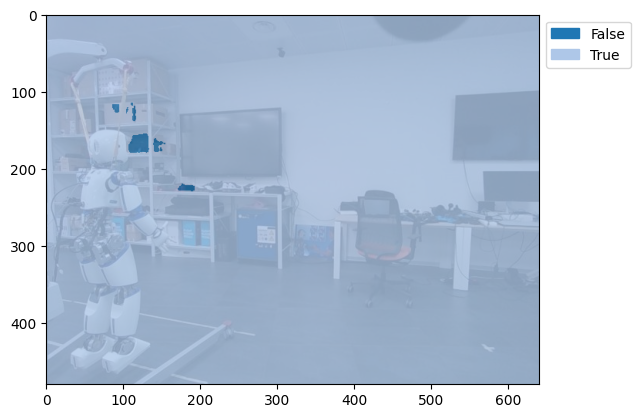

54 tensor(15) tensor(0.0034, device='cuda:0')
keep: True
CLIP classification: ['a photo of a panel.']
Projected CLIP classification: ['a photo of a ceiling.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0350], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -1.4847790002822876
geometric mean classification: ['a photo of a panel.']


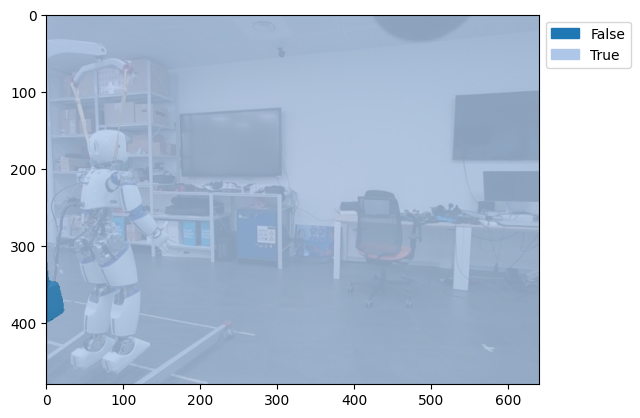

55 tensor(29) tensor(0.0035, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a wall.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.3836], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 16.25592613220215
geometric mean classification: ['a photo of a wall.']


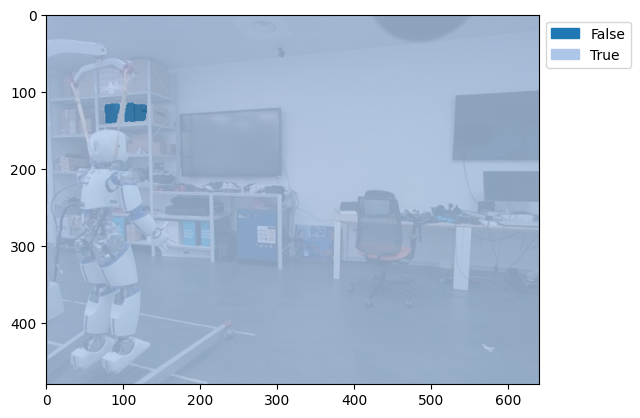

56 tensor(59) tensor(0.0035, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a table.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.3323], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 14.079529762268066
geometric mean classification: ['a photo of a panel.']


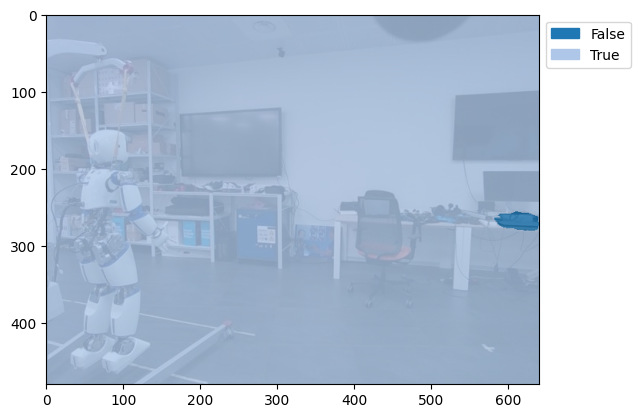

57 tensor(67) tensor(0.0035, device='cuda:0')
keep: True
CLIP classification: ['a photo of a plant.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0576], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 2.4407334327697754
geometric mean classification: ['a photo of a ceiling.']


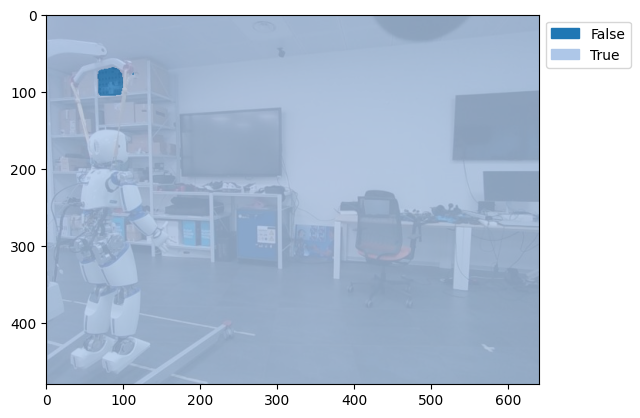

58 tensor(98) tensor(0.0039, device='cuda:0')
keep: True
CLIP classification: ['a photo of a lamp.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1988], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 8.425468444824219
geometric mean classification: ['a photo of a panel.']


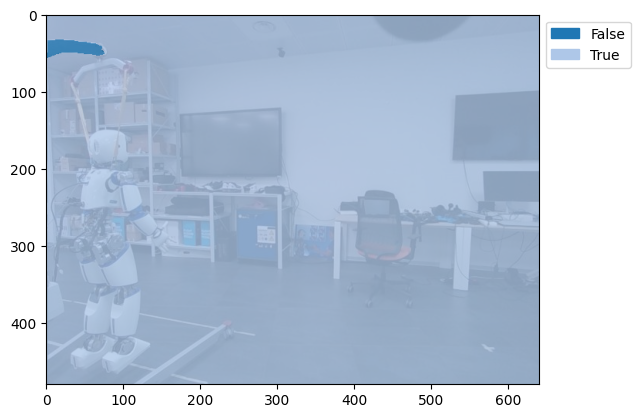

59 tensor(35) tensor(0.0041, device='cuda:0')
keep: True
CLIP classification: ['a photo of a jar.']
Projected CLIP classification: ['a photo of a door.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0653], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 2.765613317489624
geometric mean classification: ['a photo of a wall.']


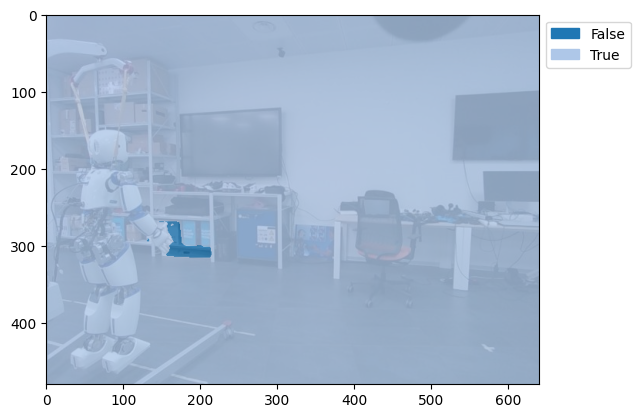

60 tensor(69) tensor(0.0043, device='cuda:0')
keep: True
CLIP classification: ['a photo of a plant.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2641], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 11.191990852355957
geometric mean classification: ['a photo of a floor.']


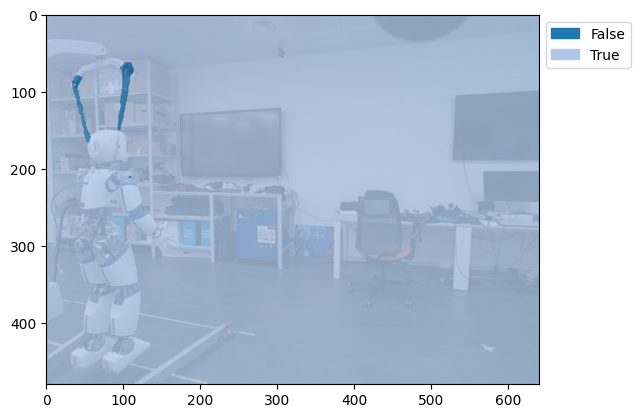

61 tensor(19) tensor(0.0048, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a wall.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1544], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 6.542836666107178
geometric mean classification: ['a photo of a panel.']


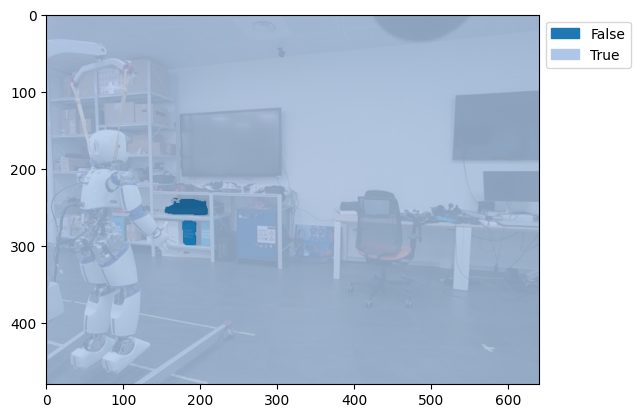

62 tensor(75) tensor(0.0048, device='cuda:0')
keep: True
CLIP classification: ['a photo of a lamp.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0242], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 1.0257186889648438
geometric mean classification: ['a photo of a lamp.']


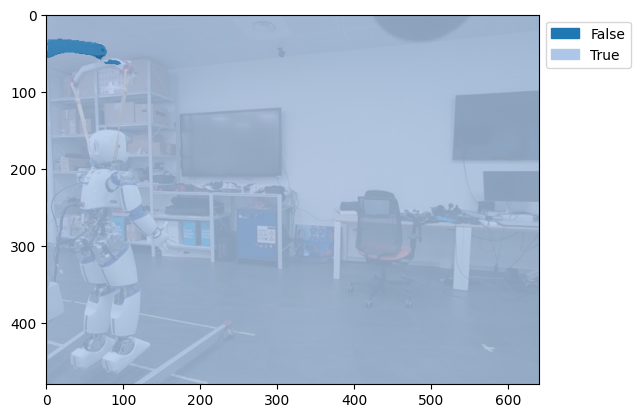

63 tensor(3) tensor(0.0049, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a laptop.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.3838], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 16.262609481811523
geometric mean classification: ['a photo of a table.']


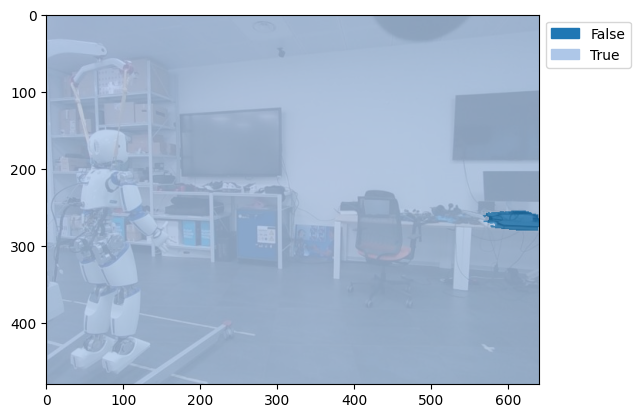

64 tensor(57) tensor(0.0060, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a sofa.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0021], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 0.08719494938850403
geometric mean classification: ['a photo of a panel.']


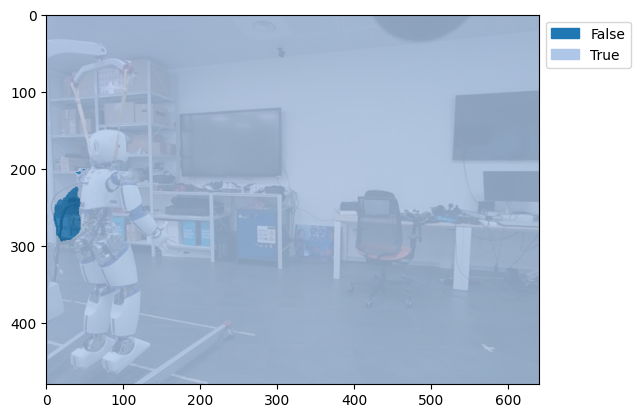

65 tensor(60) tensor(0.0065, device='cuda:0')
keep: True
CLIP classification: ['a photo of a ceiling.']
Projected CLIP classification: ['a photo of a door.']
Mask2Former classification: ['a photo of a wall.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.4187], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 17.739601135253906
geometric mean classification: ['a photo of a wall.']


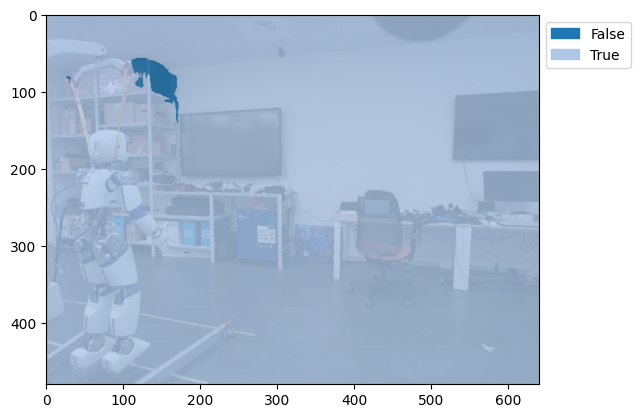

66 tensor(72) tensor(0.0065, device='cuda:0')
keep: True
CLIP classification: ['a photo of a plant.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.3283], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 13.911595344543457
geometric mean classification: ['a photo of a panel.']


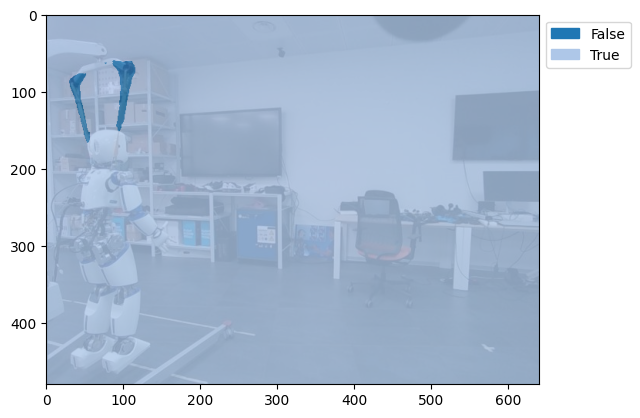

67 tensor(2) tensor(0.0076, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a carpet.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0152], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 0.6447120308876038
geometric mean classification: ['a photo of a floor.']


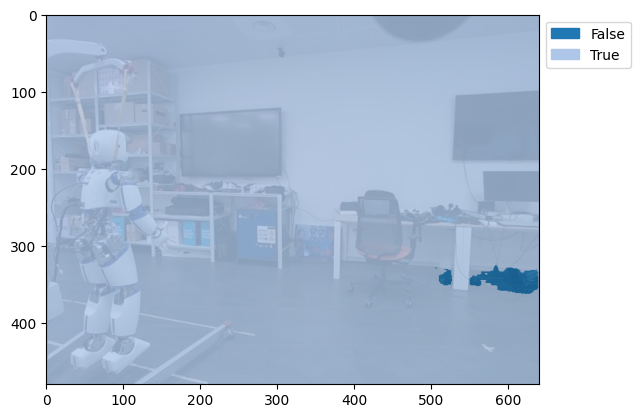

68 tensor(79) tensor(0.0079, device='cuda:0')
keep: True
CLIP classification: ['a photo of a ceiling.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2851], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 12.081643104553223
geometric mean classification: ['a photo of a ceiling.']


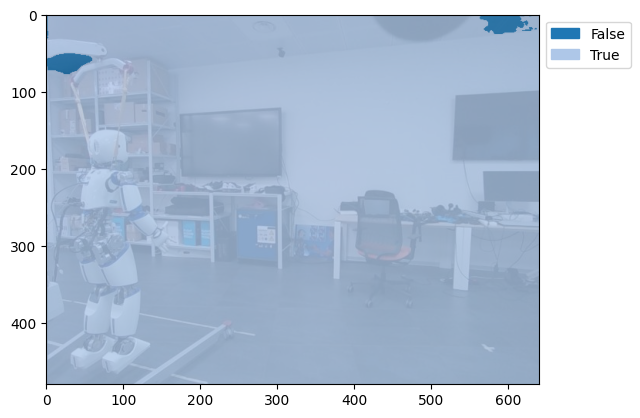

69 tensor(90) tensor(0.0081, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a table.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2398], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 10.161881446838379
geometric mean classification: ['a photo of a table.']


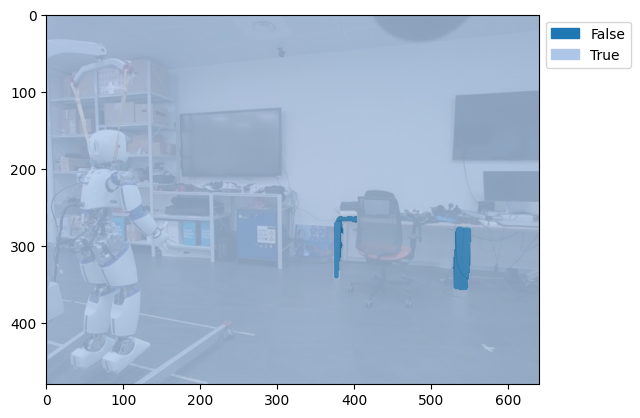

70 tensor(12) tensor(0.0083, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a sofa.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([-0.0062], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: -0.2615427076816559
geometric mean classification: ['a photo of a panel.']


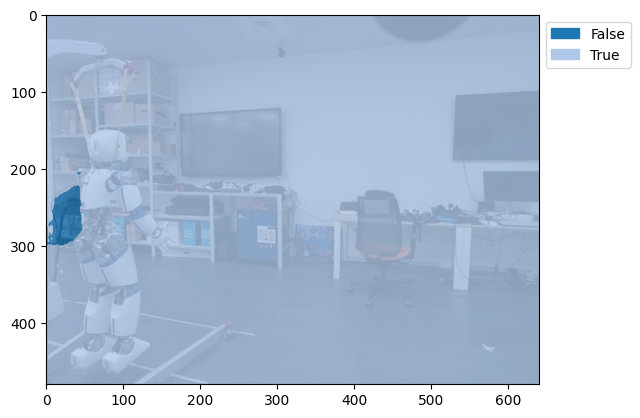

71 tensor(5) tensor(0.0094, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.4769], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 20.207530975341797
geometric mean classification: ['a photo of a panel.']


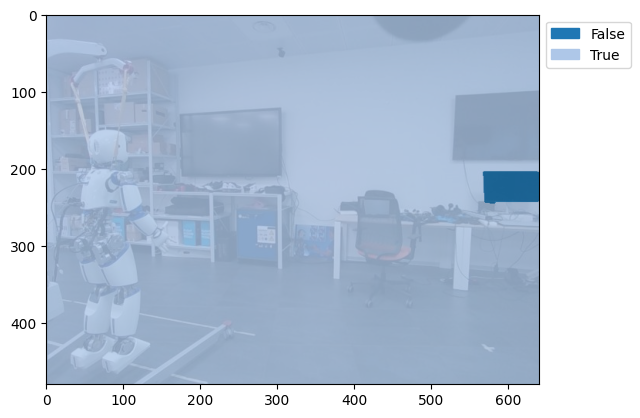

72 tensor(33) tensor(0.0098, device='cuda:0')
keep: True
CLIP classification: ['a photo of a panel.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1791], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 7.5885419845581055
geometric mean classification: ['a photo of a panel.']


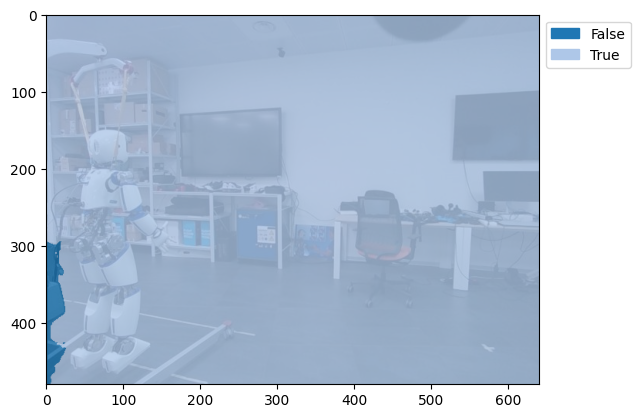

73 tensor(32) tensor(0.0108, device='cuda:0')
keep: True
CLIP classification: ['a photo of a ceiling.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0862], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 3.651715040206909
geometric mean classification: ['a photo of a panel.']


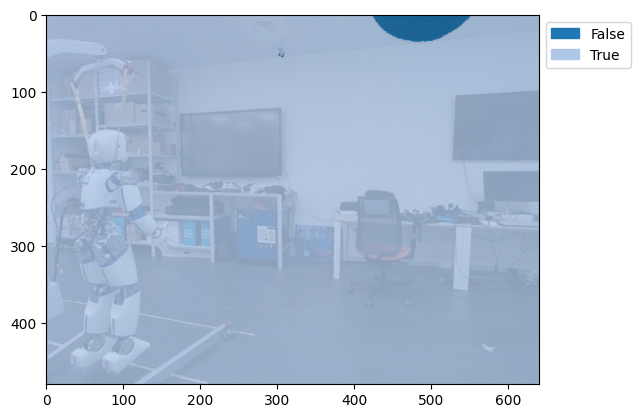

74 tensor(37) tensor(0.0108, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1924], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 8.154248237609863
geometric mean classification: ['a photo of a panel.']


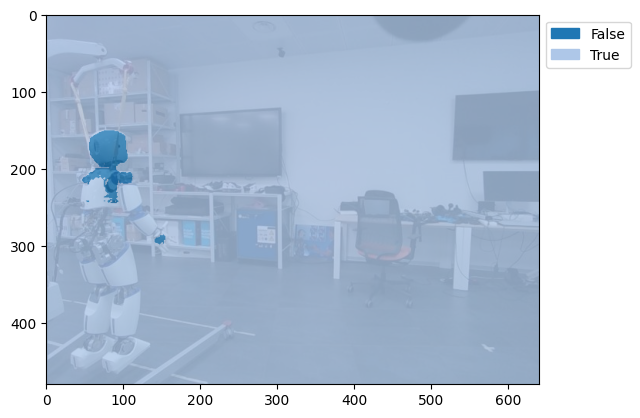

75 tensor(21) tensor(0.0108, device='cuda:0')
keep: True
CLIP classification: ['a photo of a ceiling.']
Projected CLIP classification: ['a photo of a plant.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.0979], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 4.147833347320557
geometric mean classification: ['a photo of a panel.']


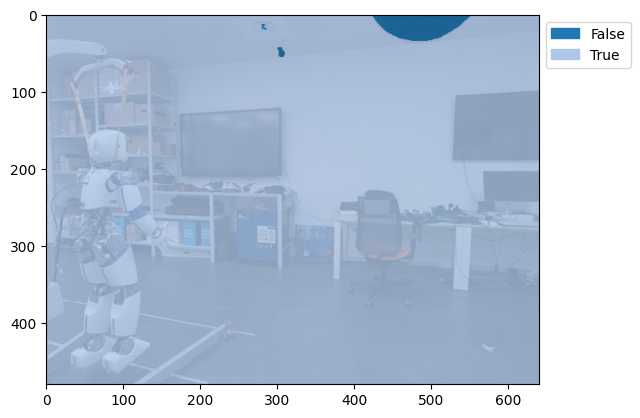

76 tensor(8) tensor(0.0123, device='cuda:0')
keep: True
CLIP classification: ['a photo of a lamp.']
Projected CLIP classification: ['a photo of a vase.']
Mask2Former classification: ['a photo of a floor.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1586], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 6.720914840698242
geometric mean classification: ['a photo of a floor.']


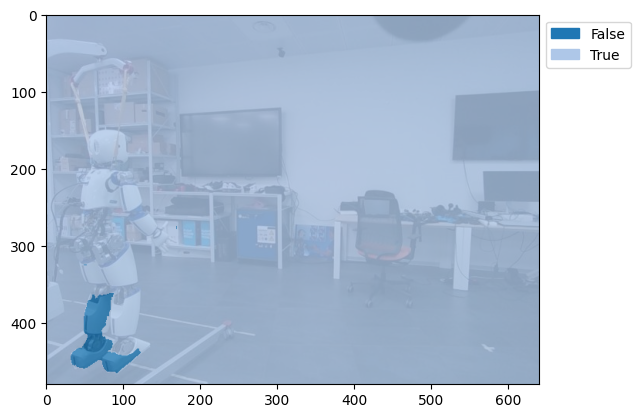

77 tensor(58) tensor(0.0129, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a table.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.4124], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 17.47336196899414
geometric mean classification: ['a photo of a table.']


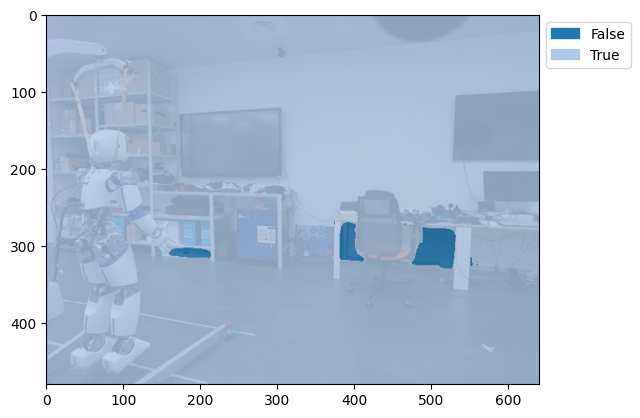

78 tensor(99) tensor(0.0150, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.4502], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 19.07654571533203
geometric mean classification: ['a photo of a wall.']


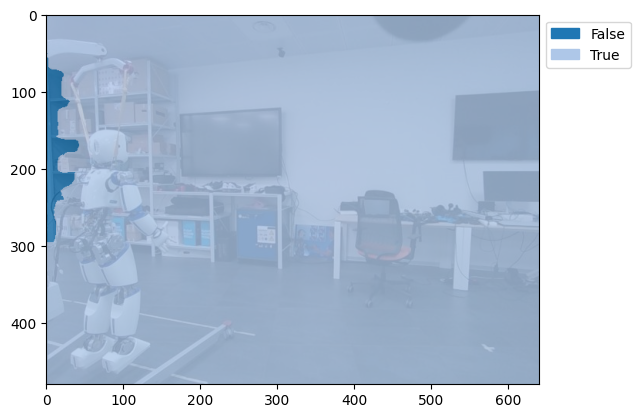

79 tensor(53) tensor(0.0162, device='cuda:0')
keep: True
CLIP classification: ['a photo of a lamp.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a ceiling.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.3600], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 15.252571105957031
geometric mean classification: ['a photo of a ceiling.']


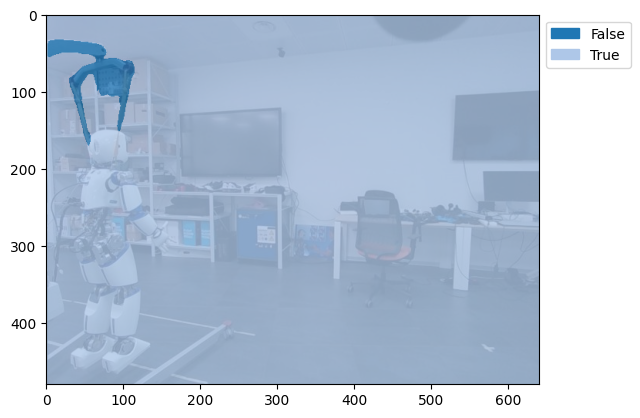

80 tensor(18) tensor(0.0168, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a jar.']
Mask2Former classification: ['a photo of a wall.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.3723], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 15.77567195892334
geometric mean classification: ['a photo of a wall.']


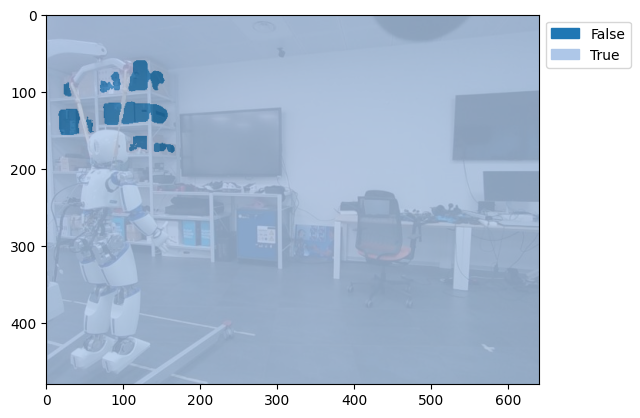

81 tensor(78) tensor(0.0172, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.4126], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 17.48323631286621
geometric mean classification: ['a photo of a panel.']


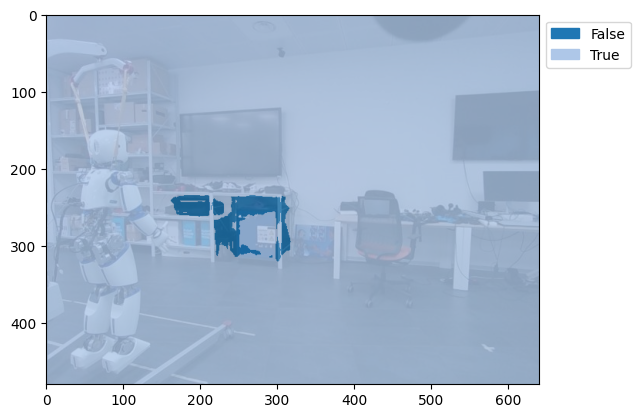

82 tensor(65) tensor(0.0177, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a laptop.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2297], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 9.733345031738281
geometric mean classification: ['a photo of a panel.']


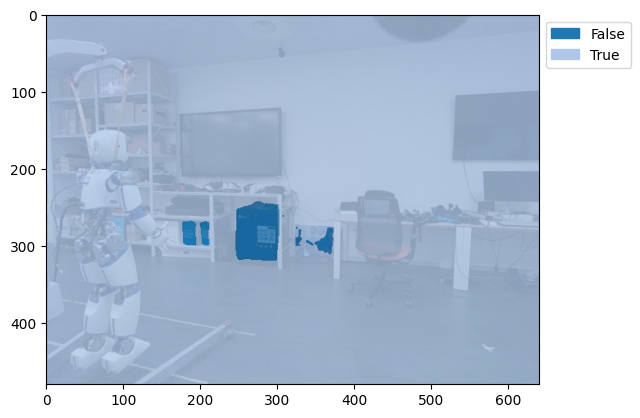

83 tensor(87) tensor(0.0216, device='cuda:0')
keep: True
CLIP classification: ['a photo of a panel.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.1345], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 5.700051307678223
geometric mean classification: ['a photo of a panel.']


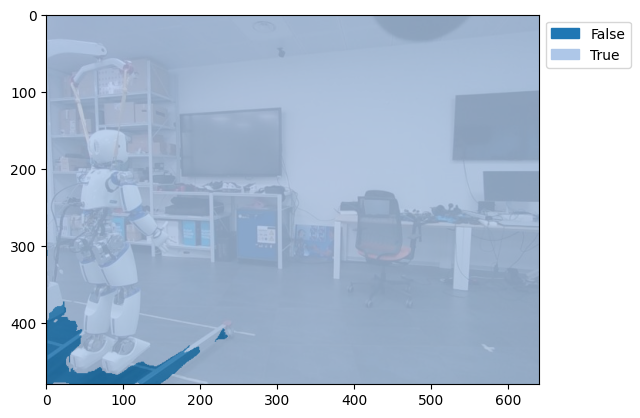

84 tensor(41) tensor(0.0223, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a table.']
Mask2Former classification: ['a photo of a table.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.4066], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 17.226919174194336
geometric mean classification: ['a photo of a table.']


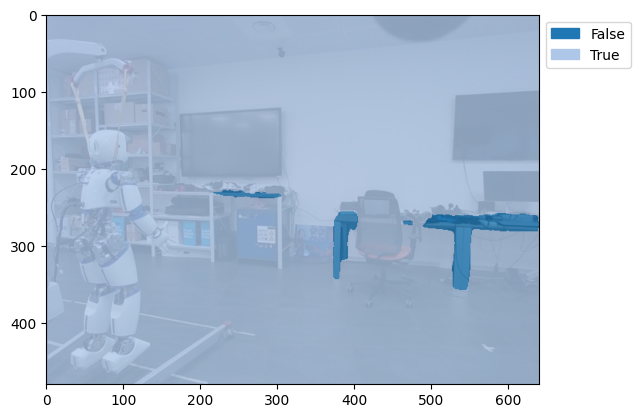

85 tensor(71) tensor(0.0251, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a table.']
Mask2Former classification: ['a photo of a table.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.4665], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 19.766429901123047
geometric mean classification: ['a photo of a table.']


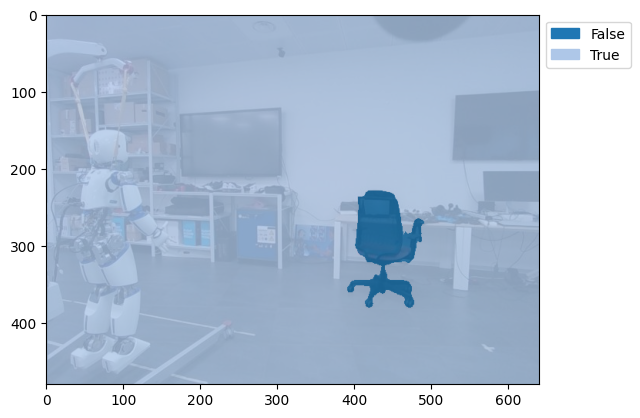

86 tensor(30) tensor(0.0304, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a table.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.4404], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 18.658987045288086
geometric mean classification: ['a photo of a table.']


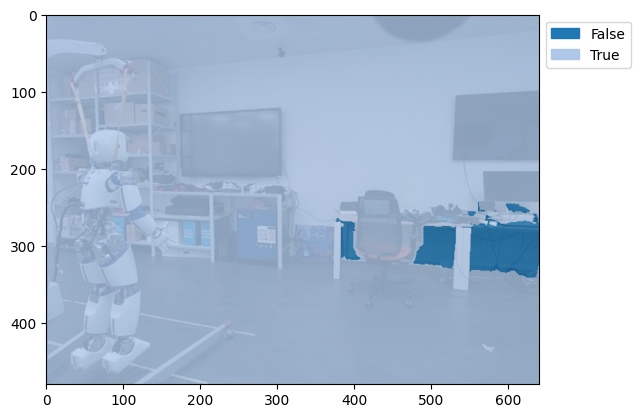

87 tensor(84) tensor(0.0306, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a laptop.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.3829], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 16.226137161254883
geometric mean classification: ['a photo of a floor.']


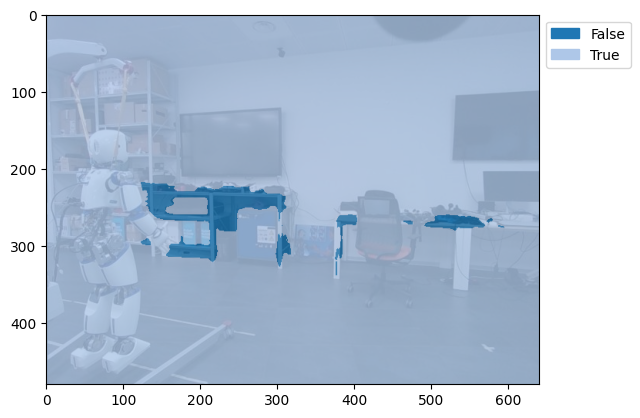

88 tensor(6) tensor(0.0316, device='cuda:0')
keep: True
CLIP classification: ['a photo of a panel.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.5658], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 23.97623634338379
geometric mean classification: ['a photo of a panel.']


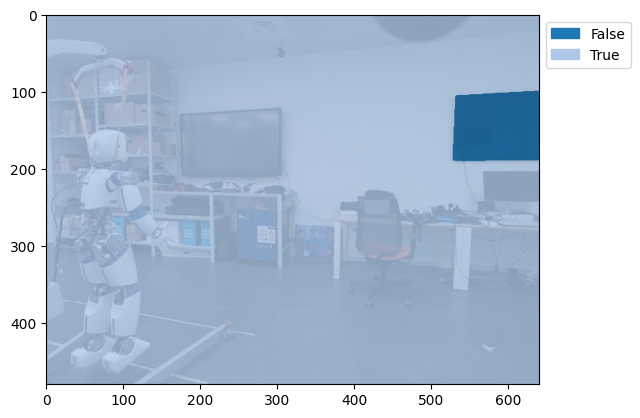

89 tensor(23) tensor(0.0352, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a lamp.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.2866], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 12.145157814025879
geometric mean classification: ['a photo of a lamp.']


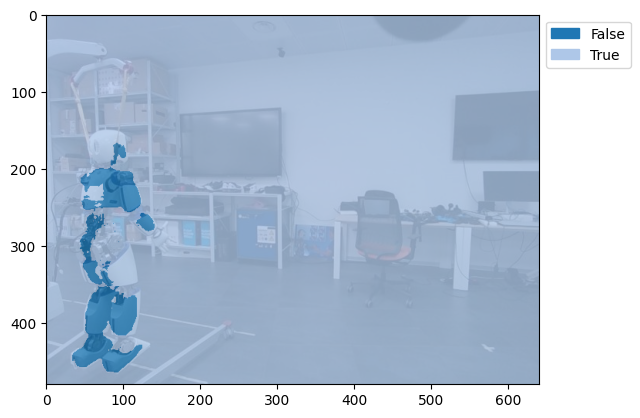

90 tensor(42) tensor(0.0372, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.5868], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 24.864648818969727
geometric mean classification: ['a photo of a panel.']


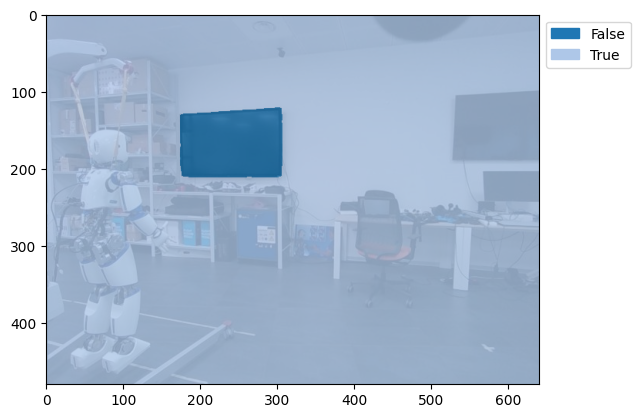

91 tensor(45) tensor(0.0722, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a lamp.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.3525], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 14.936039924621582
geometric mean classification: ['a photo of a lamp.']


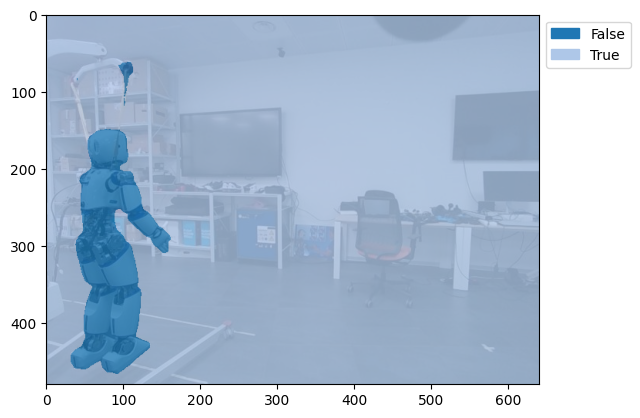

92 tensor(22) tensor(0.1036, device='cuda:0')
keep: True
CLIP classification: ['a photo of a ceiling.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a ceiling.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.3556], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 15.068951606750488
geometric mean classification: ['a photo of a ceiling.']


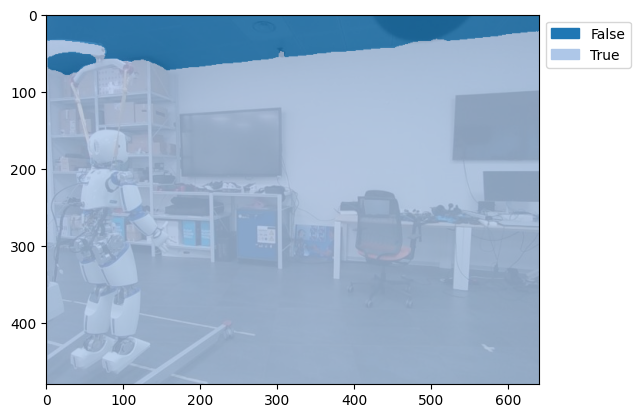

93 tensor(7) tensor(0.1258, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a ceiling.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.4091], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 17.33487892150879
geometric mean classification: ['a photo of a wall.']


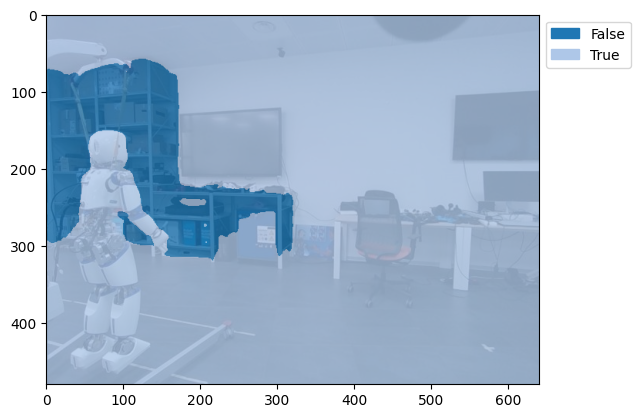

94 tensor(55) tensor(0.1326, device='cuda:0')
keep: True
CLIP classification: ['a photo of a laptop.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.4330], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 18.34715461730957
geometric mean classification: ['a photo of a panel.']


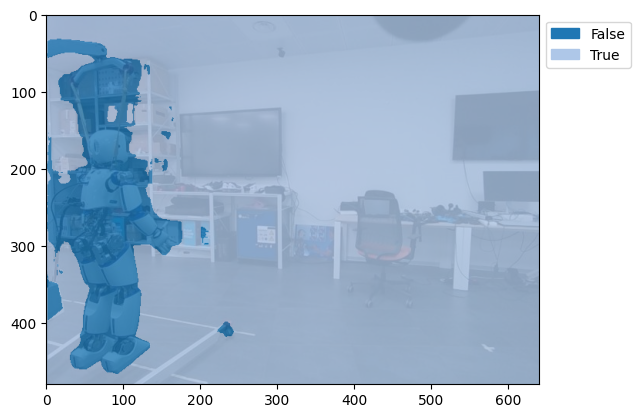

95 tensor(74) tensor(0.2017, device='cuda:0')
keep: True
CLIP classification: ['a photo of a floor.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a floor.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.5997], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 25.409029006958008
geometric mean classification: ['a photo of a floor.']


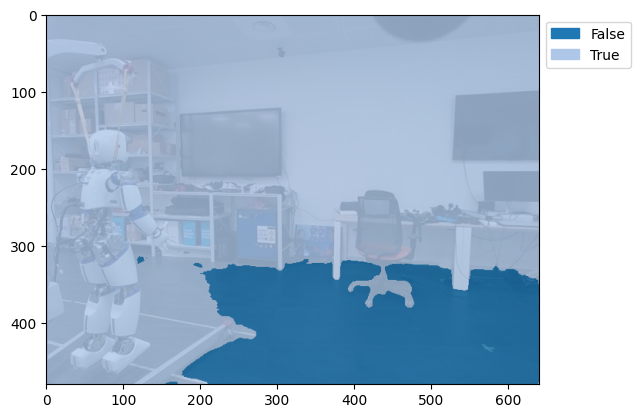

96 tensor(83) tensor(0.2522, device='cuda:0')
keep: True
CLIP classification: ['a photo of a wall.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a wall.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.5710], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 24.196325302124023
geometric mean classification: ['a photo of a wall.']


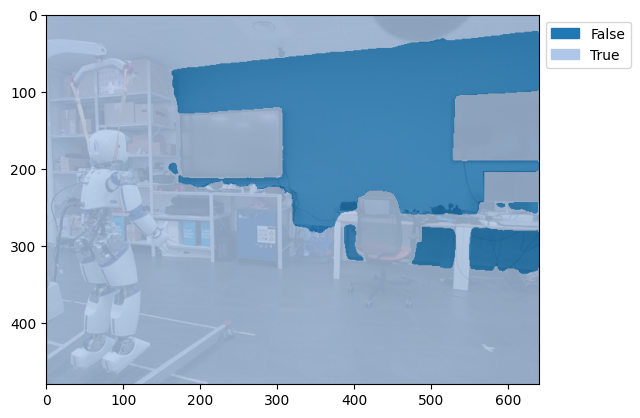

97 tensor(50) tensor(0.2910, device='cuda:0')
keep: True
CLIP classification: ['a photo of a panel.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a floor.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.5024], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 21.28927230834961
geometric mean classification: ['a photo of a floor.']


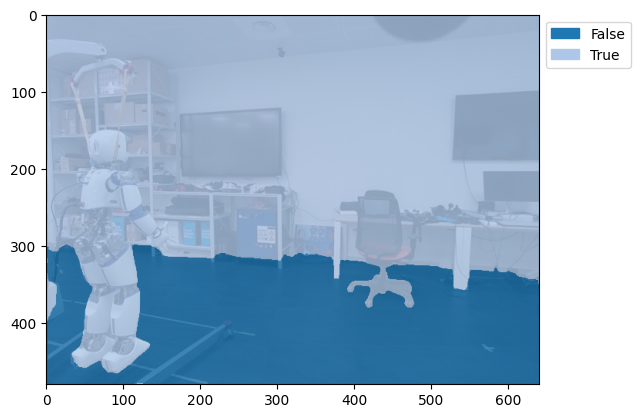

98 tensor(11) tensor(0.4467, device='cuda:0')
keep: True
CLIP classification: ['a photo of a panel.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a panel.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.6321], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 26.782150268554688
geometric mean classification: ['a photo of a panel.']


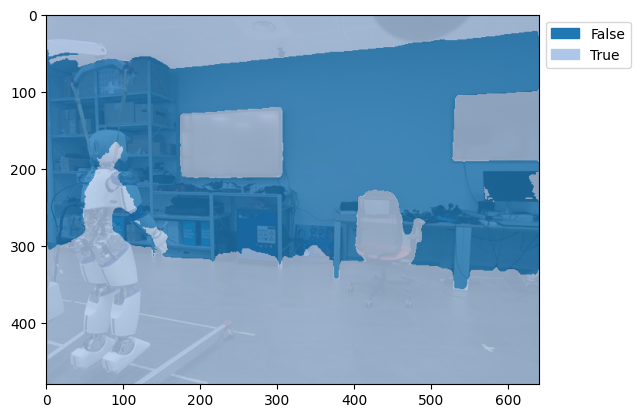

99 tensor(20) tensor(0.8857, device='cuda:0')
keep: True
CLIP classification: ['a photo of a panel.']
Projected CLIP classification: ['a photo of a panel.']
Mask2Former classification: ['a photo of a ceiling.']
Cosine Similarity between Mask2Former and projected CLIP: tensor([0.6450], device='cuda:0')
Learned M2F similarity between Mask2Former and projected CLIP: 27.328693389892578
geometric mean classification: ['a photo of a panel.']


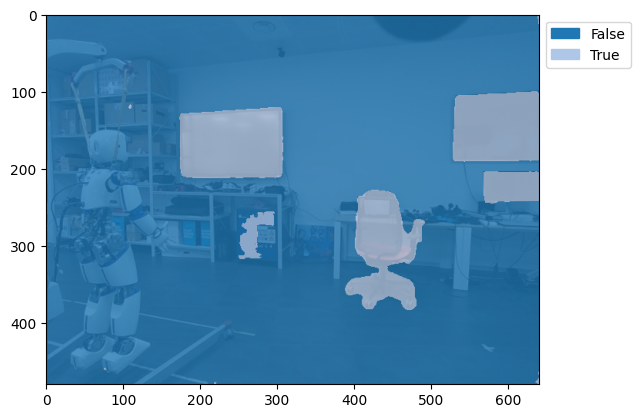

In [26]:

for i in sort_index:

    masked_image = (preds['mask_pred'][i].sigmoid() < 0.5).squeeze().squeeze()

    # Calculate percentages directly with torch operations
    one_percentage = torch.count_nonzero(masked_image) / (masked_image.shape[0] * masked_image.shape[1])
    zeros_percentage = 1 - one_percentage

    if zeros_percentage >= 0:
        print(counter, i, zeros_percentage)

        # Precompute similarity and classification outside of repeated calls if possible
        clip_classification = word_list[get_max_similarity_list_index(mask_embeds[i], embeddings)]
        projected_clip_classification = word_list[get_max_similarity_list_index(projected_clip_embeds[i], projected_embeddings)]
        mask2former_classification = word_list[get_max_similarity_list_index(projected_mask_embeds[i], projected_embeddings, ls)]

        mask2former_logits = model.cal_pred_open_logits2(projected_mask_embeds[i], projected_embeddings, ls)
        clip_logits = model.clip_head.clip.pred_logits2(mask_embeds[i].unsqueeze(0).unsqueeze(0).cuda(), embeddings.cuda(), word_list).squeeze().squeeze()

        pred_open_prob = mask2former_logits.softmax(dim=-1)
        mask_pred_open_prob = clip_logits.softmax(dim=-1)

        # pred_open_logits_base = ((pred_open_prob ** (1 - .35) * mask_pred_open_prob ** .35).log_())  # In-place log
        # pred_open_logits_bases.append(pred_open_logits_base.unsqueeze(0))

        # NOTE: logits are multiplied with logit_scale,
        # avoid double scale, which cause overflow in softmax
        pred_open_logits_base = (
            (pred_open_prob ** (1 - model.clip_head.alpha) * mask_pred_open_prob**model.clip_head.alpha).log()
            # * outputs["logit_scale"]
            * category_overlapping_mask
        )

        pred_open_logits_novel = (
            (pred_open_prob ** (1 - model.clip_head.beta) * mask_pred_open_prob**model.clip_head.beta).log()
            # * outputs["logit_scale"]
            * (1 - category_overlapping_mask)
        )

        pred_open_logits = pred_open_logits_base + pred_open_logits_novel

        max_index = pred_open_logits.argmax()

        # Process masks and handle scores, labels more efficiently
        scores, labels = F.softmax(masks_foreground_logits[i], dim=-1).max(-1)
        keep = labels.ne(1)

        print(f"keep: {keep}")

        # print(pred_open_logits_base.shape)

        print(f"CLIP classification: {clip_classification}")
        print(f"Projected CLIP classification: {projected_clip_classification}")
        print(f"Mask2Former classification: {mask2former_classification}")

        projected_clip_mask2former_similarity = torch.cosine_similarity(projected_clip_embeds[i].unsqueeze(0), projected_mask_embeds[i].unsqueeze(0))
        print(f"Cosine Similarity between Mask2Former and projected CLIP: {projected_clip_mask2former_similarity}")

        projected_clip_mask2former_distance = model.cal_pred_open_logits2(projected_mask_embeds[i], projected_clip_embeds[i], ls)
        print(f"Learned M2F similarity between Mask2Former and projected CLIP: {projected_clip_mask2former_distance}")

        print(f"geometric mean classification: {word_list[max_index]}")

        if keep or True:
            valid_mask_counter += 1

            mask_color = torch.zeros((masked_image.shape[0], masked_image.shape[1], 4), dtype=torch.float32)

            # Loop over each unique value in masked_image
            for label_value in torch.unique(masked_image):
                # Get the corresponding color from the dictionary
                color = torch.tensor(label_index_to_color_dict[label_value.item()][:4], dtype=torch.float32)  # Use [:4] for RGBA (4 channels)
                
                # Apply this color to all pixels in mask_color where masked_image == label_value
                mask_color[masked_image == label_value] = color

            labels = ["False", "True"]

            plt.imshow(input_image)
            plt.imshow(mask_color, alpha=.8)

            plt.legend(
                handles=[plt.Rectangle((0, 0), 1, 1, color=label_index_to_color_dict[i], label=labels[i]) for i in np.unique(masked_image.cpu())],
                loc='upper left',
                bbox_to_anchor=(1, 1)
            )
            plt.show()

    counter += 1


In [18]:
# pred_open_logits_bases = torch.cat(pred_open_logits_bases)
# pred_open_logits_bases.shape

In [19]:
# valid_indices = model.panoptic_inference_get_valid_mask_indices(pred_open_logits_bases, preds['mask_pred'].cpu())

scores, labels = F.softmax(masks_foreground_logits, dim=-1).max(-1)

keep = labels.ne(1)

valid_indices = keep.nonzero()

valid_indices = [vi.item() for vi in valid_indices]
valid_indices

[4, 5, 6, 7, 18, 22, 38, 41, 42, 50, 52, 64, 65, 66, 71, 75, 83, 95]

In [20]:
preds["clip_results"]["mask_embed"].shape

torch.Size([1, 100, 768])

In [21]:
preds["clip_results"].keys

<function dict.keys>

In [22]:
preds["clip_results"]["mask_pred_open_logits"].shape

torch.Size([1, 100, 14])

In [23]:
preds["panoptic_seg"][1]

[{'id': 1, 'isthing': True, 'category_id': 9, 'area': 2809.0},
 {'id': 2, 'isthing': True, 'category_id': 9, 'area': 9680.0},
 {'id': 3, 'isthing': True, 'category_id': 2, 'area': 32869.0},
 {'id': 4, 'isthing': True, 'category_id': 2, 'area': 2877.0},
 {'id': 5, 'isthing': True, 'category_id': 1, 'area': 31742.0},
 {'id': 6, 'isthing': True, 'category_id': 1, 'area': 99.0},
 {'id': 7, 'isthing': True, 'category_id': 3, 'area': 6457.0},
 {'id': 8, 'isthing': True, 'category_id': 9, 'area': 11431.0},
 {'id': 9, 'isthing': True, 'category_id': 0, 'area': 89317.0},
 {'id': 10, 'isthing': True, 'category_id': 9, 'area': 4637.0},
 {'id': 11, 'isthing': True, 'category_id': 3, 'area': 7709.0},
 {'id': 12, 'isthing': True, 'category_id': 5, 'area': 1029.0},
 {'id': 13, 'isthing': True, 'category_id': 2, 'area': 76938.0}]

(480, 640)


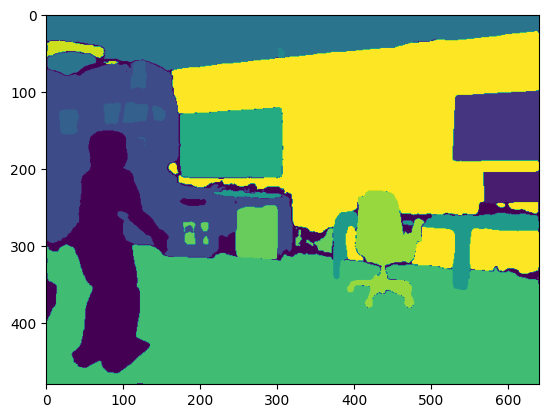

In [24]:
import matplotlib.pyplot as plt

img = preds["panoptic_seg"][0]

# img_height = preds["clip_results"]["img_height"]
# img_width = preds["clip_results"]["img_width"]

img = img.cpu().numpy()

plt.imshow(img)

print(img.shape)

In [25]:
other_embedding = word_embedder.get_and_cache_test_text_embed(labels=["other"])

projected_other_embedding = word_embedder.text_proj(other_embedding)

projected_other_embedding.shape

[10/25 15:12:10 odise.modeling.meta_arch.clip]: Using provided CLIP model
[10/25 15:12:10 odise.modeling.meta_arch.clip]: Built text_embed of shape torch.Size([1, 768]) for 1 labels: (('other',),)


torch.Size([1, 256])

In [26]:

# masked_img = preds["panoptic_seg"][0].cpu()
# instances_dict = preds["panoptic_seg"][1]

# # patched_masks = preds["clip_results"]["patch_mask"]
# patched_masks = preds["mask_pred"]

# mask_embeds = preds["clip_results"]["mask_embed"].squeeze().cpu()
# projected_mask_embeds = preds["projected_mask_embed"].squeeze().cpu().detach()
# # featured_image = torch.zeros(masked_img.shape[0], masked_img.shape[1], 768) # 768 is the embedding size of clip
# # featured_image = torch.zeros(masked_img.shape[0], masked_img.shape[1], 256) # 256 is the projected latent representation of the mask generator
# featured_image = torch.zeros(masked_img.shape[0], masked_img.shape[1], 768 + 256)

# for i in sort_index:

#     # masked_image = preds["clip_results"]["patch_mask"][:, i, :, :].unsqueeze(0)

#     # new_width, new_height = input_image.size

#     # masked_image = F.interpolate(masked_image, size=(new_height, new_width), mode='bilinear'
#     #                                         , align_corners=False
#     #                                     )

#     masked_image = preds["mask_pred"][i].sigmoid()

#     masked_image = masked_image < 0.5

#     masked_image = masked_image.squeeze().squeeze().cpu()

#     one_percentage = np.sum(masked_image.numpy()) / (masked_image.shape[0] * masked_image.shape[1])
#     zeros_percentage = 1 - one_percentage

#     if i not in valid_indices:
#         continue

#     if zeros_percentage > 0:

#         # print(masked_image.shape)
#         # print(mask_embeds[i].shape)
                
#         masked_image = masked_image.unsqueeze(-1).expand(featured_image.shape)
#         # print(masked_image.shape)
#         # print(mask_embed.shape)
#         # mask_embed = mask_embed.view(1, 1, -1)

#         # region_feats = mask_embed * (masked_image == False).float() # the regions containing True values are the ones to be masked out
#         # CLIP image embedding
#         # region_feats = torch.where(masked_image == 0, mask_embeds[i], 0) # the regions containing True values are the ones to be masked out
#         # mask2former image embedding
#         # region_feats = torch.where(masked_image == 0, projected_mask_embeds[i], 0) # the regions containing True values are the ones to be masked out
#         # stack both CLIP and Mask2Fomer image embeddings
#         #print(mask_embeds[i].shape, projected_mask_embeds[i].shape)
#         region_feats = torch.where(masked_image == 0, torch.cat((mask_embeds[i], projected_mask_embeds[i])), 0) # the regions containing True values are the ones to be masked outf

#         featured_image = torch.where(featured_image == 0, region_feats, featured_image)

# if torch.count_nonzero(featured_image) < masked_image.shape[0] * masked_image.shape[1] * featured_image.shape[-1]:

#     print(torch.count_nonzero(featured_image) / (masked_image.shape[0] * masked_image.shape[1] * featured_image.shape[-1]))

#     # print("Interpolation to fill the gaps") # actually it makes things worse, better fill the gaps with other embedding

#     # new_height, new_width, new_depth = featured_image.shape

#     # featured_image = F.interpolate(featured_image.unsqueeze(0).unsqueeze(0), size=(int(new_height / 10), int(new_width / 10), new_depth), mode='trilinear'
#     #                                 , align_corners=False
#     #                             )

#     # featured_image = F.interpolate(featured_image, size=(new_height, new_width, new_depth), mode='trilinear'
#     #                                 , align_corners=False

#     #                         )
#     # fill the gaps with "other" embeddings

#     # featured_image = torch.where(featured_image == 0, other_embedding, featured_image)
#     # featured_image = torch.where(featured_image == 0, projected_other_embedding, featured_image)
#     featured_image = torch.where(featured_image == 0, torch.cat((other_embedding.squeeze(), projected_other_embedding.squeeze())), featured_image)
    
# # featured_image = featured_image.squeeze(0)


In [27]:
masked_img = preds["panoptic_seg"][0]
# instances_dict = preds["panoptic_seg"][1]

# Use the mask embeddings directly without squeezing repeatedly inside the loop
mask_embeds = preds["clip_results"]["mask_embed"].squeeze()
projected_mask_embeds = preds["projected_mask_embed"].detach().squeeze()

featured_image = torch.zeros(masked_img.shape[0], masked_img.shape[1], 768 + 256).cuda()

feat_shape = featured_image.shape

# print(instances_dict.is_cuda)

discarded_coherent_masks = []

for i in sort_index:
    projected_clip_mask2former_distance = torch.cosine_similarity(projected_clip_embeds[i].unsqueeze(0), projected_mask_embeds[i].unsqueeze(0))
    # print(f"Cosine Similarity between Mask2Former and CLIP: {projected_clip_mask2former_distance.item()}")

    if i not in valid_indices:
        if projected_clip_mask2former_distance.item() > 0.3:
            discarded_coherent_masks.append(i)
        continue

    masked_image = preds["mask_pred"][i].sigmoid_() < 0.5
    masked_image = masked_image.squeeze().unsqueeze(-1).expand(feat_shape)

    # Only calculate percentage once
    zeros_percentage = (masked_image == 0).float().mean().item()

    if zeros_percentage > 0:
        region_feats = torch.cat((mask_embeds[i], projected_mask_embeds[i]))
        featured_image[:] = torch.where((masked_image == 0) & (featured_image == 0), region_feats, featured_image)

for i in discarded_coherent_masks:

    masked_image = preds["mask_pred"][i].sigmoid_() < 0.5
    masked_image = masked_image.squeeze().unsqueeze(-1).expand(feat_shape)

    # Only calculate percentage once
    zeros_percentage = (masked_image == 0).float().mean().item()

    if zeros_percentage > 0:
        region_feats = torch.cat((mask_embeds[i], projected_mask_embeds[i]))
        featured_image[:] = torch.where((masked_image == 0) & (featured_image == 0), region_feats, featured_image)


# Check non-zero elements in one go
if torch.count_nonzero(featured_image) < masked_img.shape[0] * masked_img.shape[1] * featured_image.shape[-1]:
    print(torch.count_nonzero(featured_image) / (masked_img.shape[0] * masked_img.shape[1] * featured_image.shape[-1]))
    featured_image = torch.where(featured_image == 0, torch.cat((other_embedding.squeeze(), projected_other_embedding.squeeze())), featured_image)


tensor(0.9991, device='cuda:0')


In [28]:
import gc

# del featured_image
# del zeros_percentage

gc.collect()
torch.cuda.empty_cache()

In [29]:
featured_image.shape

torch.Size([480, 640, 1024])

# Query the embeddings

In [205]:
# vocab = "chair; picture; ceiling light; lamp; ground; ceiling; robot; table; monitor; wall; floor; person; laptop; keyboard; mouse; screen; computer; tv; monitor; display; desk; window; shelf; other; others"

# vocab = "chair; picture; floor; ceiling; robot; table; monitor; wall; laptop; screen; computer; tv; shelf; desk; window; person; other"

# vocab = "person; man; woman; child; cloud; angel; stairs; floor; column; tree; arch; sky; wall; animal"

# vocab = "person; man; woman; child; cloud; angel; stairs; floor; column; tree; sky; ground; wall"
# vocab = "chair; ceiling; robot; tv; table; wall; floor; person; laptop; shelf; monitor; computer; window; picture; screen; desk; other"
# vocab = "floor; ceiling; wall; table; laptop; lamp; plant; vase; jar; couch; sofa; carpet; door"

vocab = "wall; other"

word_lists = vocab.split("; ")

colors = ""
# colors = "white; green; red; blue; yellow; orange; cyan"

category_list = []

if colors:
    color_list = colors.split("; ")
    
for wl in word_lists:
    category_list.append([w for w in wl.split(", ")])
    if colors:
        for c in color_list:
            category_list.append([f"{c} {w}" for w in wl.split(", ")])

word_list = []
word_list = prompt_labels(labels=category_list, prompt="photo")
# word_list += [[""]]
# category_list += [[""]]
# word_list += [["other"]]
# category_list += [["other"]]
# word_list += [["other"], ["others"], [""]]
# category_list += [["other"], ["others"], [""]]
# embeddings = word_embedder.get_and_cache_test_text_embed(labels=word_list).cpu()
embeddings = word_embedder.get_and_cache_test_text_embed(labels=word_list)

projected_embeddings = word_embedder.text_proj(embeddings).detach()

category_overlapping_list = []

for test_label in category_list:
    category_overlapping_list.append(not set(train_labels).isdisjoint(set(test_label)))

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

category_overlapping_mask = torch.tensor(
    category_overlapping_list, device=device, dtype=torch.long
)

# projected_embeddings = word_embedder.text_proj(embeddings).cpu().detach()

[10/25 15:44:21 odise.modeling.meta_arch.clip]: Using provided CLIP model
[10/25 15:44:21 odise.modeling.meta_arch.clip]: Built text_embed of shape torch.Size([2, 768]) for 2 labels: (('a photo of a wall.',), ('a photo of a other.',))


In [206]:
# open_seg_mask = torch.zeros(featured_image.shape[0], featured_image.shape[1], 3)

# label_index_to_color_dict = {i : plt.cm.get_cmap('tab20')(i) for i in range(len(embeddings))}

# for i in range(open_seg_mask.shape[0]):
#     for j in range(open_seg_mask.shape[1]):
#         feat_embedding = featured_image[i, j]

#         clip_embedding = feat_embedding[:768]
#         mask2former_embedding = feat_embedding[768:]

#         # print(feat_embedding.shape)
#         # cosi = torch.nn.CosineSimilarity(dim=0)
        
#         # CLIP case
#         # max_index = get_max_similarity_list_index(feat_embedding, embeddings)
#         # Mask2Former case
#         # max_index = get_max_similarity_list_index(feat_embedding, projected_embeddings, ls)

#         #clip + mask2former case
#         mask2former_logits = model.cal_pred_open_logits2(mask2former_embedding, projected_embeddings, ls, word_list)

#         # print(clip_embedding.is_cuda)
#         # print(embeddings.is_cuda)

#         clip_logits = model.clip_head.clip.pred_logits(clip_embedding.unsqueeze(0).unsqueeze(0), embeddings, word_list).squeeze().squeeze()
#         # clip_logits = model.clip_head.clip.pred_logits(clip_embedding.unsqueeze(0).unsqueeze(0).cuda(), embeddings.cuda(), word_list).squeeze().squeeze()
        
#         # print(mask2former_logits.shape)
#         # print(clip_logits.shape)

#         pred_open_prob = mask2former_logits.softmax(dim=-1)

#         # mask_pred_open_prob = clip_logits.softmax(dim=-1).cpu()
#         mask_pred_open_prob = clip_logits.softmax(dim=-1)

#         # NOTE: logits are multiplied with logit_scale,
#         # avoid double scale, which cause overflow in softmax
#         pred_open_logits_base = (
#             (pred_open_prob ** (1 - .35) * mask_pred_open_prob** .35).log()
#             # * outputs["logit_scale"]
#         )

#         # print(pred_open_logits_base.shape)

#         # max_index = np.array(pred_open_logits_base.detach()).argmax()
#         max_index = pred_open_logits_base.detach().argmax().item()

#         # open_seg_mask[i, j, :] = torch.tensor(label_index_to_color_dict[max_index][:3])
#         open_seg_mask[i, j] = torch.tensor(label_index_to_color_dict[max_index][:3])

#         # print((i + 1) * open_seg_mask.shape[0] + j , query_similarity, other_similarity)
        

In [207]:
# Precompute color mappings outside loop
# color_len = 20
# shades_num = 1
# transformed_colors = []

# while len(embeddings) > color_len:
#     color_len += 20
#     shades_num += 1

# if shades_num > 1:

#     print("added shades")

#     for c in plt.cm.get_cmap('tab20').colors:
#         # define 10 colors that come from 10 transformations of the original color
#         for i in range(shades_num):
#             # apply shade transformation based on the index
#             # transformed_colors.append([c[j] * ((i * 5 + 50)) / 100 for j in range(3)] + [1.0])
#             col = [c[j] for j in range(3)] + [(i + 1) / shades_num]
#             print(col)
#             transformed_colors.append(col)

# else:
#     print("no shades")
#     transformed_colors = [list(c) + [1.0] for c in plt.cm.get_cmap('tab20').colors]

# print(len(transformed_colors))

# print(len(embeddings))

# label_index_to_color_dict = {i : torch.tensor(transformed_colors[i][:4]) for i in range(len(embeddings))}

# label_index_to_color_dict = {i: torch.tensor(plt.cm.get_cmap('gist_rainbow', len(embeddings))(i)[:4]) for i in range(len(embeddings))}

colors = plt.cm.nipy_spectral(np.linspace(0, 1, len(embeddings)))

label_index_to_color_dict = {i: torch.tensor(colors[i]) for i in range(len(embeddings))}

# Initialize open_seg_mask
open_seg_mask = torch.zeros(featured_image.shape[0], featured_image.shape[1], 4)

# Vectorized embeddings extraction (batch processing instead of pixel-by-pixel)
clip_embeddings = featured_image[:, :, :768]
mask2former_embeddings = featured_image[:, :, 768:]

# Batch compute logits for all pixels
mask2former_logits = model.cal_pred_open_logits2(mask2former_embeddings, projected_embeddings, ls)

# Compute CLIP logits in batch

clip_logits = model.clip_head.clip.pred_logits(clip_embeddings, embeddings, word_list).squeeze(-1)

# Compute open probabilities and logits in batch
pred_open_prob = mask2former_logits.softmax(dim=-1)
mask_pred_open_prob = clip_logits.softmax(dim=-1)

# # Compute the final logits in batch
# pred_open_logits_base = (pred_open_prob ** (1 - .35) * mask_pred_open_prob** .35).log()

pred_open_logits_base = (
    (pred_open_prob ** (1 - model.clip_head.alpha) * mask_pred_open_prob**model.clip_head.alpha).log()
    # * outputs["logit_scale"]
    * category_overlapping_mask
)

pred_open_logits_novel = (
    (pred_open_prob ** (1 - model.clip_head.beta) * mask_pred_open_prob**model.clip_head.beta).log()
    # * outputs["logit_scale"]
    * (1 - category_overlapping_mask)
)

pred_open_logits = pred_open_logits_base + pred_open_logits_novel

# Get max indices for all pixels in batch
max_indices = pred_open_logits.detach().argmax(dim=-1)

# Update open_seg_mask using tensor indexing
open_seg_mask = torch.stack([label_index_to_color_dict[idx.item()] for idx in max_indices.flatten()]).view(open_seg_mask.shape)


In [208]:
embeddings.shape

torch.Size([2, 768])

In [209]:
print(len(word_list))
print(word_list)

2
[['a photo of a wall.'], ['a photo of a other.']]


In [210]:
detected_categories = torch.unique(max_indices)
detected_categories

tensor([0, 1], device='cuda:0')

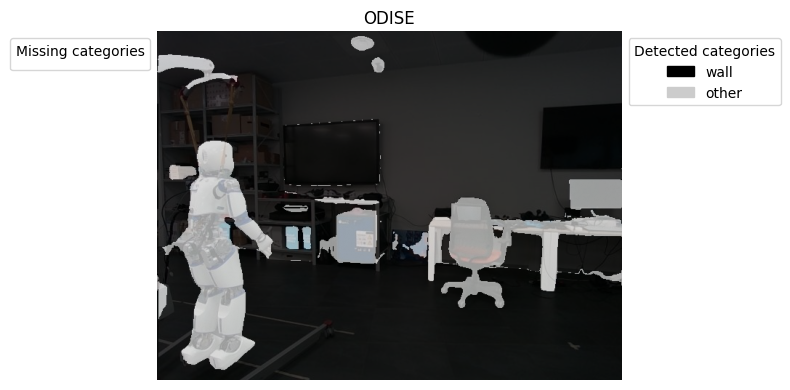

In [211]:
fig, ax = plt.subplots()

plt.imshow(input_image)
plt.imshow(open_seg_mask, alpha=.75)

found_categories_legend = ax.legend(handles=[plt.Rectangle((0,0),1,1, color=np.array(label_index_to_color_dict[int(i)]),                                                       
                                        label=[w for wl in category_list for w in wl][int(i)]) for i in range(len(embeddings)) if i in detected_categories],
                                        title = "Detected categories",   
                                        loc='upper left', bbox_to_anchor=(1, 1),
                                        )

missing_categories_legend = plt.legend(handles=[plt.Rectangle((0,0),1,1, color=np.array(label_index_to_color_dict[int(i)]),
                                        label=[w for wl in category_list for w in wl][int(i)]) for i in range(len(embeddings)) if i not in detected_categories],
                                        title= "Missing categories",
                                        loc='upper right', bbox_to_anchor=(0, 1),
                                        )

# Manually add the first legend back to the plot
fig.add_artist(found_categories_legend)

format = "svg"

plt.title("ODISE")

plt.axis("off")

plt.tight_layout()

plt.savefig(f'odise.{format}', format=format, bbox_inches='tight')

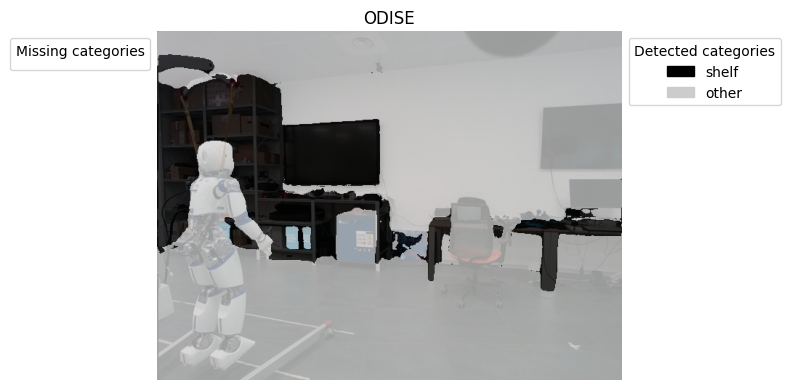

In [154]:
fig, ax = plt.subplots()

plt.imshow(input_image)
plt.imshow(open_seg_mask, alpha=.75)

found_categories_legend = ax.legend(handles=[plt.Rectangle((0,0),1,1, color=np.array(label_index_to_color_dict[int(i)]),                                                       
                                        label=[w for wl in category_list for w in wl][int(i)]) for i in range(len(embeddings)) if i in detected_categories],
                                        title = "Detected categories",   
                                        loc='upper left', bbox_to_anchor=(1, 1),
                                        )

missing_categories_legend = plt.legend(handles=[plt.Rectangle((0,0),1,1, color=np.array(label_index_to_color_dict[int(i)]),
                                        label=[w for wl in category_list for w in wl][int(i)]) for i in range(len(embeddings)) if i not in detected_categories],
                                        title= "Missing categories",
                                        loc='upper right', bbox_to_anchor=(0, 1),
                                        )

# Manually add the first legend back to the plot
fig.add_artist(found_categories_legend)

format = "svg"

plt.title("ODISE")

plt.axis("off")

plt.tight_layout()

plt.savefig(f'odise.{format}', format=format, bbox_inches='tight')

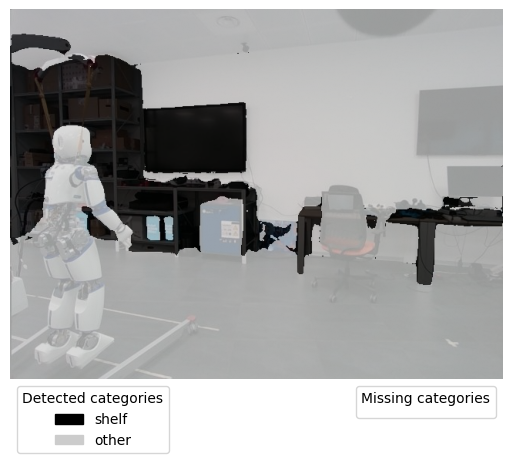

In [155]:
fig, ax = plt.subplots()

plt.imshow(input_image)
plt.imshow(open_seg_mask, alpha=.75)
# found_categories_legend.remove()

found_categories_legend = ax.legend(handles=[plt.Rectangle((0,0),1,1, color=np.array(label_index_to_color_dict[int(i)]),                                                       
                                        label=[w for wl in category_list for w in wl][int(i)]) for i in range(len(embeddings)) if i in detected_categories],
                                        title = "Detected categories",   
                                        loc='upper left', bbox_to_anchor=(0, 0),
                                        )

missing_categories_legend = plt.legend(handles=[plt.Rectangle((0,0),1,1, color=np.array(label_index_to_color_dict[int(i)]),
                                        label=[w for wl in category_list for w in wl][int(i)]) for i in range(len(embeddings)) if i not in detected_categories],
                                        title= "Missing categories",
                                        loc='upper right', bbox_to_anchor=(1, 0),
                                        )

# Manually add the first legend back to the plot
fig.add_artist(found_categories_legend)

# plt.tight_layout()

plt.axis("off")

plt.show()

# plt.legend(handles=[plt.Rectangle((0,0),1,1, color=np.array(label_index_to_color_dict[int(i)]), label=[w for wl in word_list for w in wl][int(i)]) for i in range(len(embeddings))], loc='upper left', bbox_to_anchor=(1, 1))

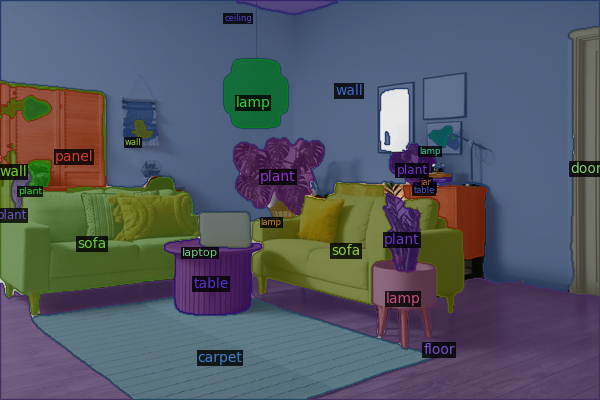

In [284]:
vis_output